# Descriere Generala

În practica de zi cu zi a unui inginer sau cercetător în domeniul învățării automate intra
frecvent următoarele trei aspecte:
* Vizualizarea și “explorarea” datelor unei probleme (Exploratory Data Analysis)
* Încercarea de a extrage atribute ale datelor problemei pentru a fi utilizate în obiectivul
de analiza ales (e.g. clasificare, regresie, detectie de anomalii)
* Investigarea de modele de rețele neurale potrivite pentru extragerea “automată” de
atribute care ajută în obiectivul de analiză ales

În perioada recentă, date de la senzori de orice fel ajung să fie folosiți cu scopul de a colecta
date despre procese dinamice, care evoluează în timp  de la gesturi umane până la date
despre trafic sau tiparul de consum electric al unei gospodării tipice.

Seturile de date alese spre explorare și analiză vor surprinde astfel de procese. În particular,
problemele propuse spre analiză fac parte din categoria celor de clasificare a seriilor
temporale.

* *Sarcinile voastre de lucru vor solicita utilizarea de biblioteci de vizualizare a datelor
(crearea de diagrame), extragerea de atribute (feature extraction) pentru folosirea
algoritmilor de clasificare discutați la curs, precum și utilizarea modelelor de rețele neurale
convoluționale și recurente**



# Imports

In [ ]:
# Import the necessary libraries

from google.colab import drive
import os
!pip install -q sktime
import sktime
from sktime.datasets import load_from_arff_to_dataframe
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import warnings
from sklearn.preprocessing import StandardScaler, MinMaxScaler
from scipy.signal import find_peaks
from scipy.stats import skew, kurtosis
from sklearn.feature_selection import VarianceThreshold
from sklearn.svm import SVC
from sklearn.metrics import accuracy_score
from sklearn.metrics import classification_report
from sklearn.metrics import confusion_matrix
from sklearn import svm
from sklearn.model_selection import GridSearchCV
from sklearn import preprocessing
from xgboost import XGBClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import precision_score
from sklearn.metrics import recall_score
from sklearn.metrics import f1_score
from sklearn import metrics
!pip install tabulate
from tabulate import tabulate

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


# Descrierea Seturilor de Date

In [ ]:
# Connect to Google Drive

drive.mount('/content/gdrive')

Mounted at /content/gdrive


# RacketSports

---



**RacketSports** este un set de date ce conține înregistrări de smart watch făcute în timpul unui
joc de badminton sau squash. Datele descriu semnale de accelerație (pe axele x, y și z) și giroscop (rotație pe axele x, y și z), surprinzând **înregistrări de 3 secunde** etichetate ca
reprezentând tipul de mișcare din joc (forehand / rever pentru squash și clear / smash pentru
badminton).

Senzorii sunt eșantionați cu o frevență de **10 Hz**, astfel că fiecare secvență din setul de date
are o **lungime de 30**. Există **151** de secvențe în setul de date de antrenare și **152** în setul de
test.

* *Scopul este cel de a clasifica fiecare secvența de valori inerțiale ca una din cele 4
acțiuni (forehand, rever, clear, smash).
Notă: Descărcarea setului de date RacketSports se face de la aceasta adresa: https://www.timeseriesclassification.com/description.php?Dataset=RacketSports*

In [ ]:
# Load data from an ARFF file into a Pandas DataFrame

DATA_PATH = "/content/gdrive/MyDrive/RacketSports/"

X_train, y_train = load_from_arff_to_dataframe(
    os.path.join(DATA_PATH, "RacketSports_TRAIN.arff") , has_class_labels=True
)

X_test, y_test = load_from_arff_to_dataframe(
    os.path.join(DATA_PATH, "RacketSports_TEST.arff") , has_class_labels=True
)

X_train['label'] = y_train
X_test['label'] = y_test

print(X_train.head(1)["dim_0"])

print(X_train["dim_0"][0])
print(type(X_train["dim_0"][0]))

print(len(X_train))

0    0      1.266676
1     -2.180751
2     -0.94334...
Name: dim_0, dtype: object
0      1.266676
1     -2.180751
2     -0.943348
3      0.440631
4      1.562197
5      0.248300
6      1.667997
7      1.143273
8     -0.354614
9      0.025025
10    -2.094929
11     1.409416
12   -15.843610
13   -22.661740
14   -15.777729
15   -11.565274
16     0.184927
17     2.184308
18    -2.918847
19    -1.438143
20    -1.832789
21    -2.392894
22    -2.936923
23    -1.699626
24    -1.699626
25    -0.559298
26    -0.559298
27    -0.559298
28    -0.559298
29    -0.559298
dtype: float64
<class 'pandas.core.series.Series'>
151


In [ ]:
y_test

array(['Badminton_Smash', 'Badminton_Smash', 'Badminton_Smash',
       'Badminton_Smash', 'Badminton_Smash', 'Badminton_Smash',
       'Badminton_Smash', 'Badminton_Smash', 'Badminton_Smash',
       'Badminton_Smash', 'Badminton_Smash', 'Badminton_Smash',
       'Badminton_Smash', 'Badminton_Smash', 'Badminton_Smash',
       'Badminton_Smash', 'Badminton_Smash', 'Badminton_Smash',
       'Badminton_Smash', 'Badminton_Smash', 'Badminton_Smash',
       'Badminton_Smash', 'Badminton_Smash', 'Badminton_Smash',
       'Badminton_Smash', 'Badminton_Smash', 'Badminton_Smash',
       'Badminton_Smash', 'Badminton_Smash', 'Badminton_Smash',
       'Badminton_Smash', 'Badminton_Smash', 'Badminton_Smash',
       'Badminton_Smash', 'Badminton_Smash', 'Badminton_Smash',
       'Badminton_Smash', 'Badminton_Smash', 'Badminton_Smash',
       'Badminton_Smash', 'Badminton_Clear', 'Badminton_Clear',
       'Badminton_Clear', 'Badminton_Clear', 'Badminton_Clear',
       'Badminton_Clear', 'Badminton_Cle

# Explorarea Datelor (Exploratory Data Analysis) [2p]

Primul pas cerut în rezolvarea unei probleme de clasificare este câștigarea unor cunoștințe asupra caracteristicilor principale ale problemei.

De regulă, foarte folositoare în această etapă este aplicarea unor metode de vizualizare a datelor și de raportare a distribuțiilor de valori pe fiecare variabila folosită în predicție

## 1. Analiza echilibrului de clase

  Realizați un grafic al frecvenței de apariție a fiecărei etichete (clase) în setul de date de
  antrenare / test, folosind barplot-uri / countplot.
  Pentru realizarea unor astfel de barplot-uri puteți folosi mai multe biblioteci: *text cursiv*

    ● Folosind biblioteca seaborn pentru barplot sau countplot

    ● Direct dintr-un DataFrame Pandas folosind pandas.DataFrame.plot.bar

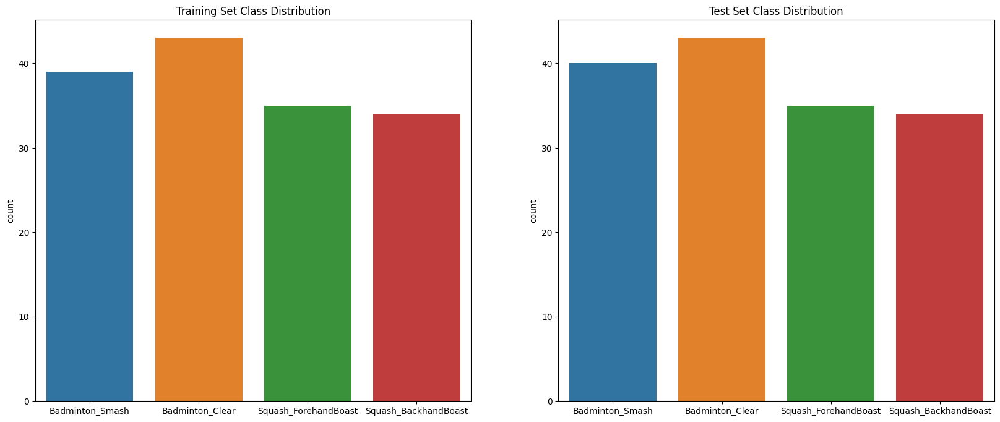

In [ ]:
# Analyze class balance

fig, axs = plt.subplots(1, 2, figsize=(20, 8))
sns.countplot(x=y_train, ax=axs[0])
axs[0].set_title("Training Set Class Distribution")
sns.countplot(x=y_test, ax=axs[1])
axs[1].set_title("Test Set Class Distribution")
plt.show()

## 2. Vizualizarea seriilor de timp

    Afișați câte un exemplu de serie pentru fiecare tip de acțiune (în setul de date
RacketSports)

      ● Afișați valorile de accelerometru pe dimensiunile x, y și z pe același
      grafic.

      ● Afișați valorile de giroscop pe dimensiunile x, y și z pe același grafic.


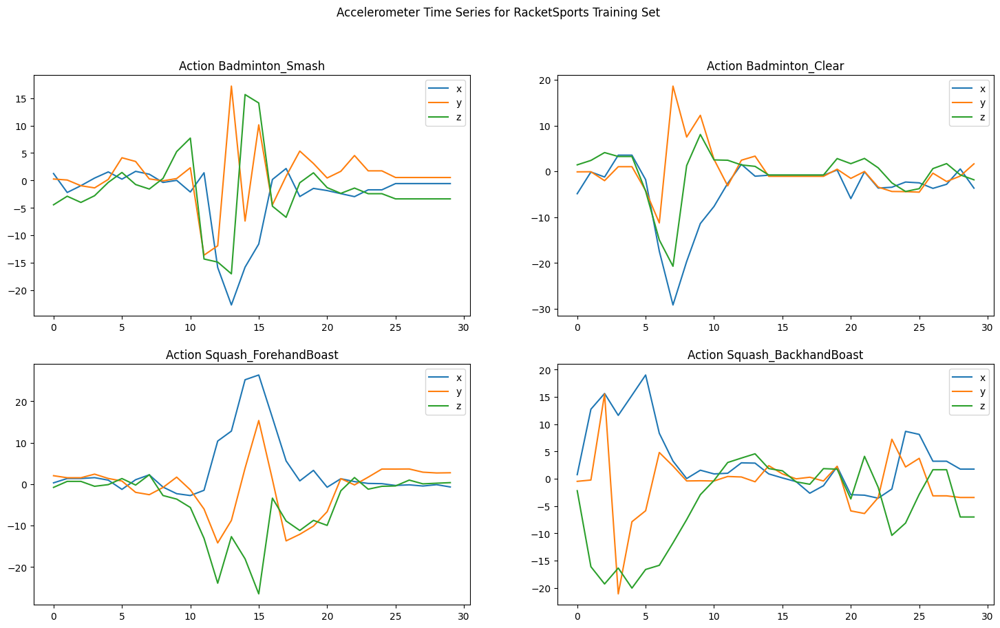

In [ ]:
# Visualize time series

def plot_time_series(X, y, title):
    fig, axs = plt.subplots(2, 2, figsize=(18, 10))
    for idx, i in enumerate(["Badminton_Smash", "Badminton_Clear", "Squash_ForehandBoast", "Squash_BackhandBoast"]):
        ax = axs[idx // 2][idx % 2]
        idx = np.where(y == i)[0][0]
        x_vals = X.iloc[idx].values
        t_vals = np.arange(len(x_vals[0]))

        ax.plot(t_vals, x_vals[0], label="x")
        ax.plot(t_vals, x_vals[1], label="y")
        ax.plot(t_vals, x_vals[2], label="z")
        ax.set_title(f"Action {i}")
        ax.legend()
    fig.suptitle(title)
    plt.show()

# Plot accelerometer and gyroscope time series
plot_time_series(X_train, y_train, "Accelerometer Time Series for RacketSports Training Set")

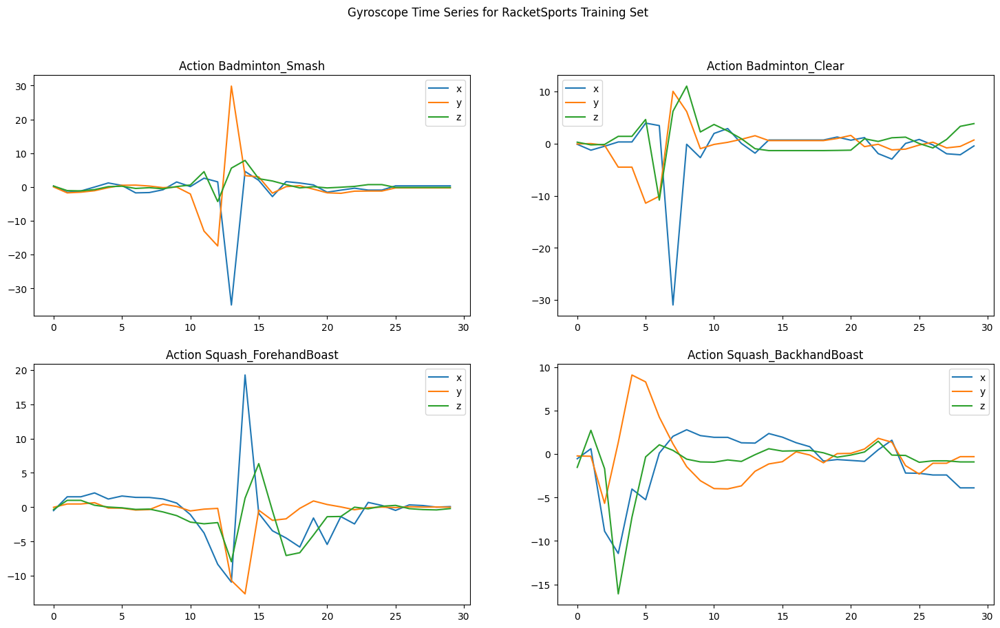

In [ ]:
# Visualize time series

def plot_time_series(X, y, title):
    fig, axs = plt.subplots(2, 2, figsize=(18, 10))
    for idx, i in enumerate(["Badminton_Smash", "Badminton_Clear", "Squash_ForehandBoast", "Squash_BackhandBoast"]):
        ax = axs[idx // 2][idx % 2]
        idx = np.where(y == i)[0][0]
        x_vals = X.iloc[idx].values
        t_vals = np.arange(len(x_vals[3]))

        # print(i, x_vals, t_vals)

        ax.plot(t_vals, x_vals[3], label="x")
        ax.plot(t_vals, x_vals[4], label="y")
        ax.plot(t_vals, x_vals[5], label="z")
        ax.set_title(f"Action {i}")
        ax.legend()
    fig.suptitle(title)
    plt.show()

# Plot accelerometer and gyroscope time series
plot_time_series(X_train, y_train, "Gyroscope Time Series for RacketSports Training Set")

*Pentru setul de date RacketSports afișați distribuția valorilor per fiecare axă de accelerometru și giroscop în parte / per acțiune (a se vedea un exemplu fictiv de output în Figura 1). O astfel de analiză este utilă pentru a determina dacă există niște șabloane imediate care se pot observa în termen de valori specifice pe x, y și z pentru fiecare gest în parte. Aceste șabloane (e.g. intervale de valori specifice) pot fi folosite în etapa de definire a atributelor și pot totodată informa dacă problema este una ușoară (șabloane de valori clar diferențiabile per gest) sau grea (distribuții similare per fiecare gest).*


In [ ]:
# Suppressing warning messages

warnings.filterwarnings('ignore')

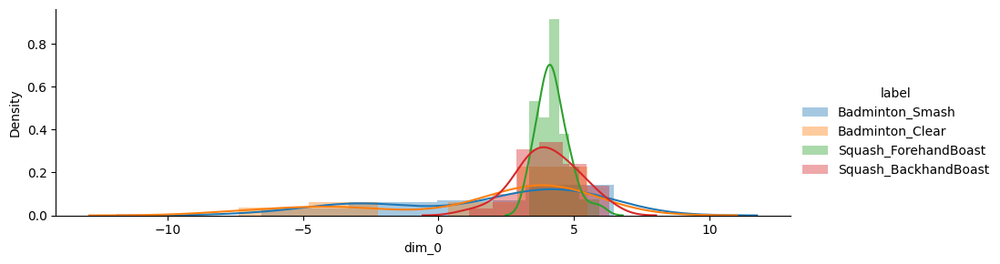

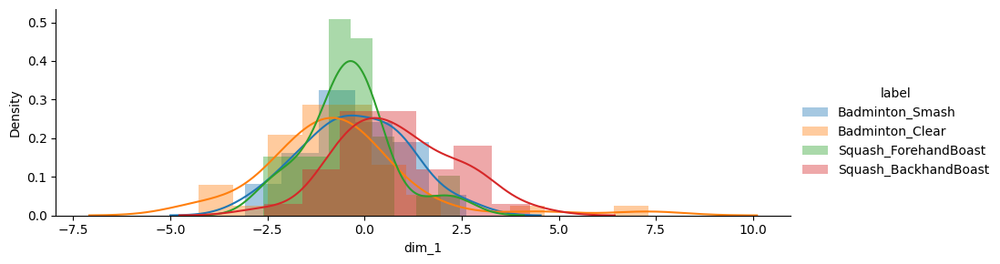

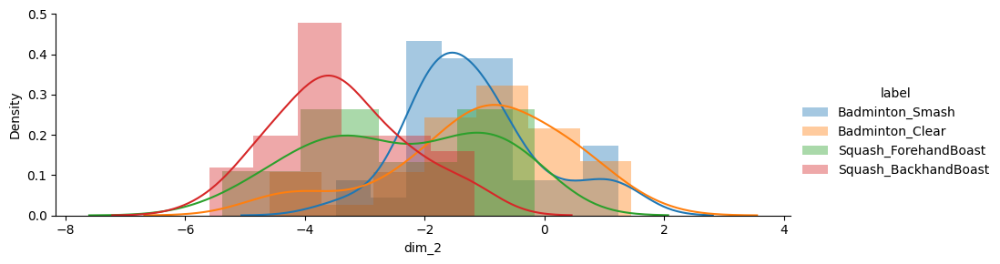

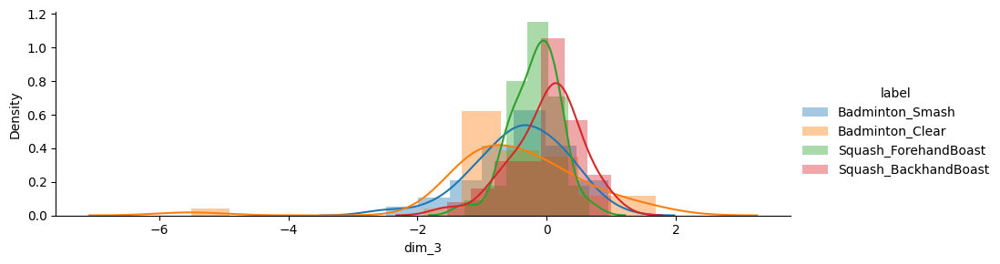

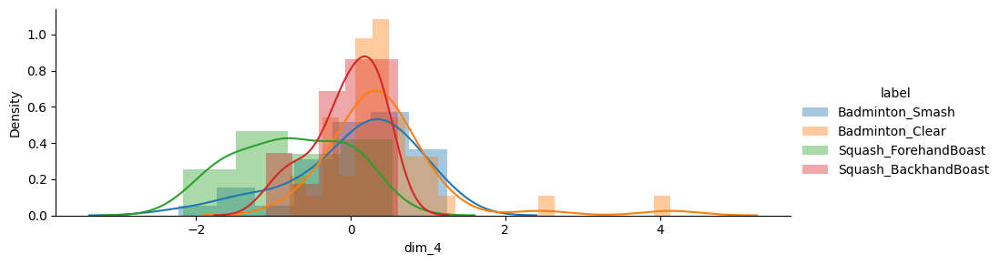

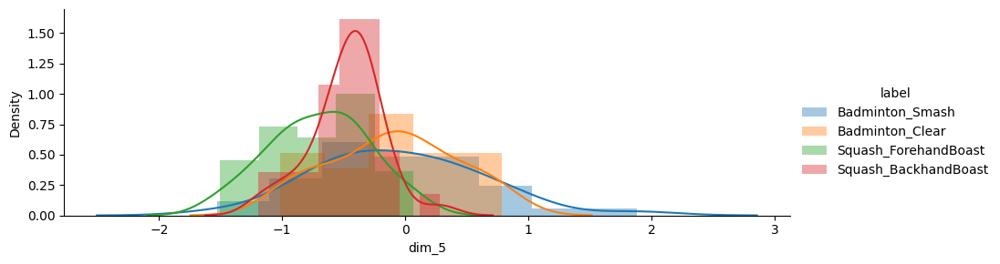

In [ ]:
# Create a new dataframe called "means" that contains the mean values for each feature in the training data,
# as well as the corresponding label

data = X_train
means = data.apply(lambda x: pd.Series([x["dim_0"].mean(),
                                          x["dim_1"].mean(),
                                          x["dim_2"].mean(),
                                          x["dim_3"].mean(),
                                          x["dim_4"].mean(),
                                          x["dim_5"].mean(),
                                          x["label"]], index=['dim_0', 'dim_1', 'dim_2', 'dim_3', 'dim_4', 'dim_5', "label"]), axis=1)

# Reset the index of the "means" dataframe, dropping the previous index

means = means.reset_index()
means = means.drop(['index'], axis=1)

# Create a facet grid plot using seaborn, showing the distribution of each feature in the "means" dataframe
# separated by label
g = sns.FacetGrid(means, hue="label", aspect=3).map(sns.distplot, "dim_0").add_legend()
g = sns.FacetGrid(means, hue="label", aspect=3).map(sns.distplot, "dim_1").add_legend()
g = sns.FacetGrid(means, hue="label", aspect=3).map(sns.distplot, "dim_2").add_legend()
g = sns.FacetGrid(means, hue="label", aspect=3).map(sns.distplot, "dim_3").add_legend()
g = sns.FacetGrid(means, hue="label", aspect=3).map(sns.distplot, "dim_4").add_legend()
g = sns.FacetGrid(means, hue="label", aspect=3).map(sns.distplot, "dim_5").add_legend()

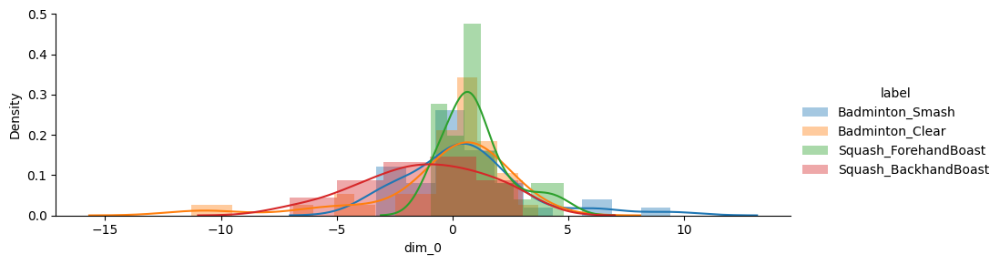

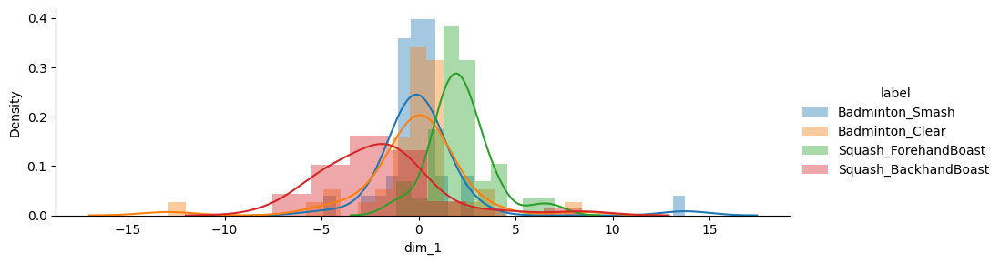

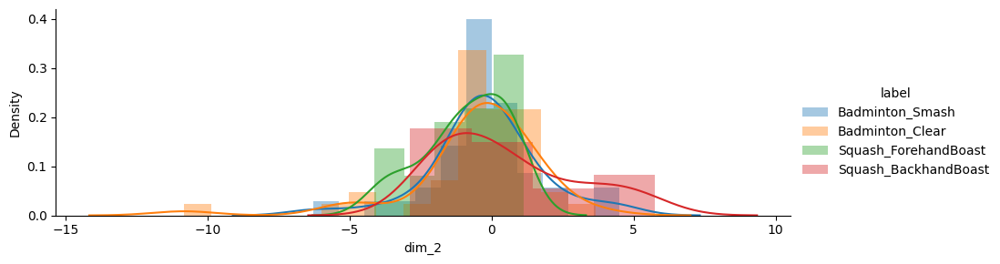

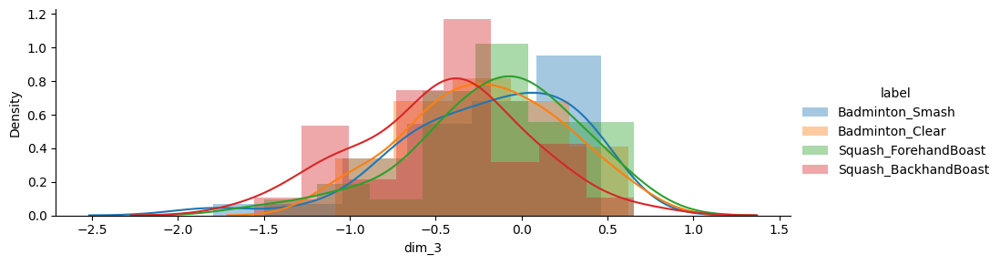

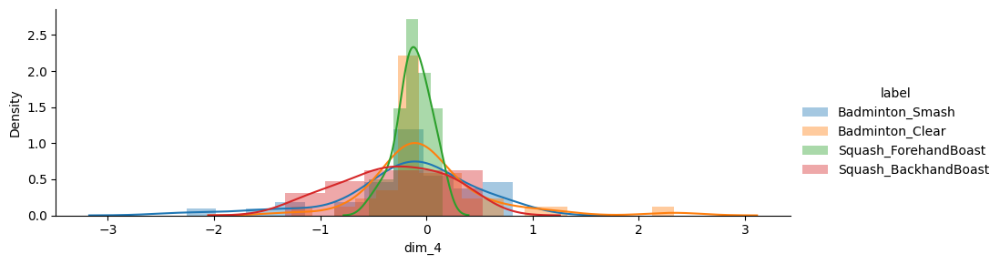

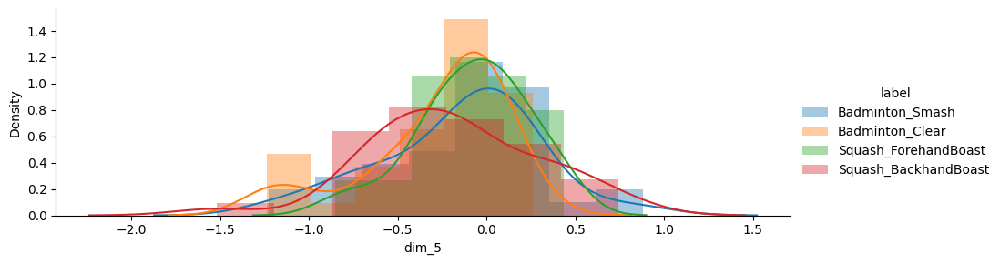

In [ ]:
# Extract data but for the time = 0 for the series of each axes.
data = X_train

i = 0
means = data.apply(lambda x: pd.Series([x["dim_0"][i],
                                          x["dim_1"][i],
                                          x["dim_2"][i],
                                          x["dim_3"][i],
                                          x["dim_4"][i],
                                          x["dim_5"][i],
                                          x["label"]], index=['dim_0', 'dim_1', 'dim_2', 'dim_3', 'dim_4', 'dim_5', "label"]), axis=1)

# Reset the index and drop the old index column
means = means.reset_index()
means = means.drop(['index'], axis=1)

# Plot the density plots using Seaborn FacetGrid
g = sns.FacetGrid(means, hue="label", aspect=3).map(sns.distplot, "dim_0").add_legend()
g = sns.FacetGrid(means, hue="label", aspect=3).map(sns.distplot, "dim_1").add_legend()
g = sns.FacetGrid(means, hue="label", aspect=3).map(sns.distplot, "dim_2").add_legend()
g = sns.FacetGrid(means, hue="label", aspect=3).map(sns.distplot, "dim_3").add_legend()
g = sns.FacetGrid(means, hue="label", aspect=3).map(sns.distplot, "dim_4").add_legend()
g = sns.FacetGrid(means, hue="label", aspect=3).map(sns.distplot, "dim_5").add_legend()

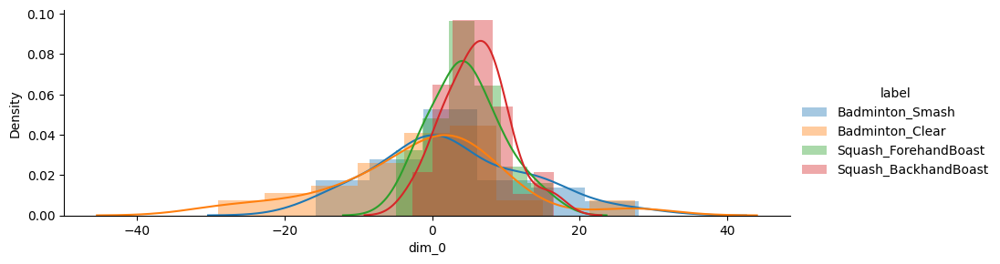

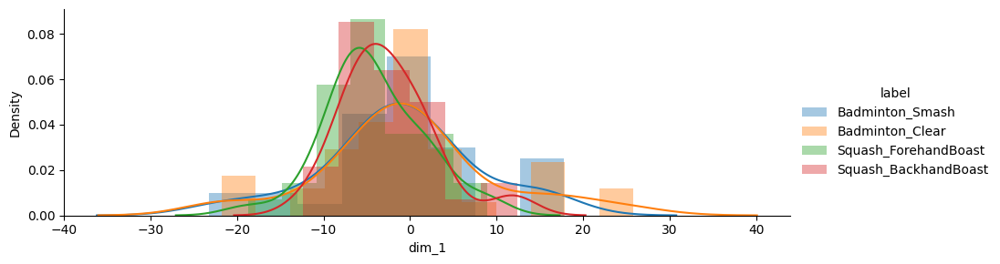

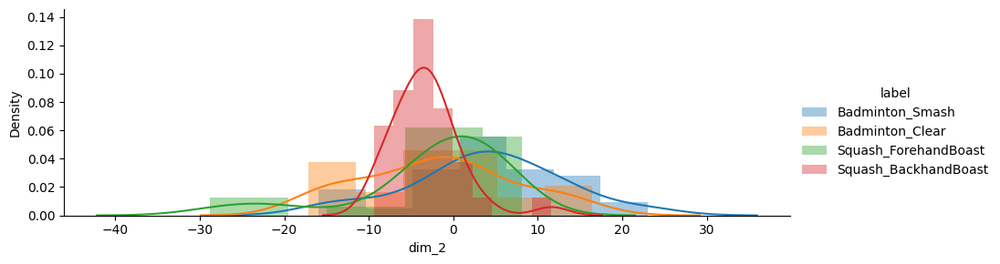

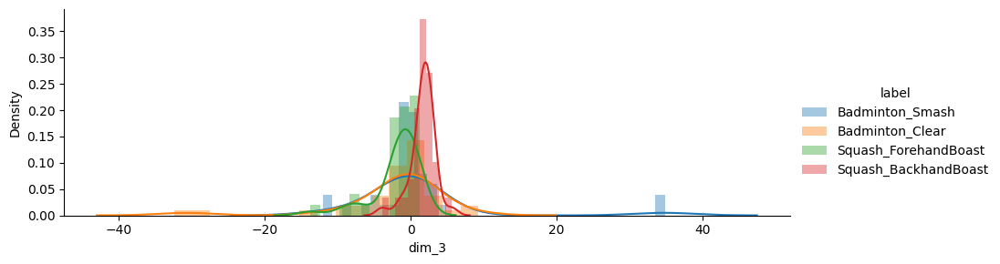

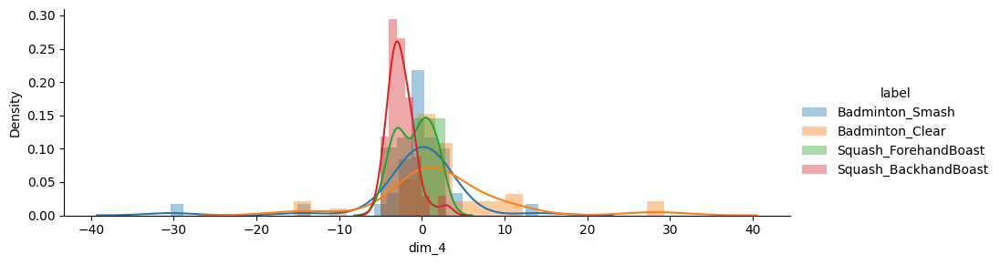

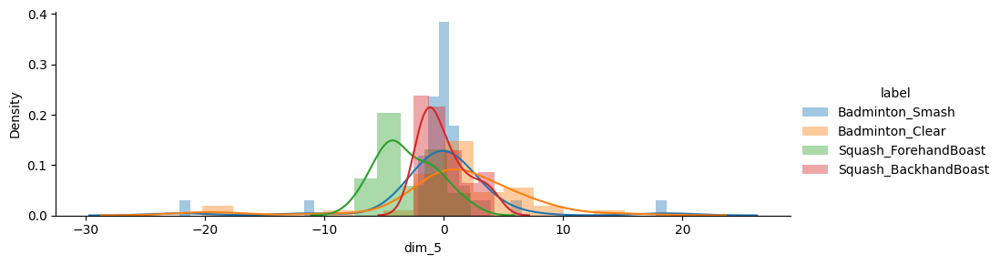

In [ ]:
# Extract data but for the time = 10 for the series of each axes.
data = X_train
  
i = 10
means = data.apply(lambda x: pd.Series([x["dim_0"][i],
                                          x["dim_1"][i],
                                          x["dim_2"][i],
                                          x["dim_3"][i],
                                          x["dim_4"][i],
                                          x["dim_5"][i],
                                          x["label"]], index=['dim_0', 'dim_1', 'dim_2', 'dim_3', 'dim_4', 'dim_5', "label"]), axis=1)

# Reset the index and drop the old index column
means = means.reset_index()
means = means.drop(['index'], axis=1)

# Plot the density plots using Seaborn FacetGrid
g = sns.FacetGrid(means, hue="label", aspect=3).map(sns.distplot, "dim_0").add_legend()
g = sns.FacetGrid(means, hue="label", aspect=3).map(sns.distplot, "dim_1").add_legend()
g = sns.FacetGrid(means, hue="label", aspect=3).map(sns.distplot, "dim_2").add_legend()
g = sns.FacetGrid(means, hue="label", aspect=3).map(sns.distplot, "dim_3").add_legend()
g = sns.FacetGrid(means, hue="label", aspect=3).map(sns.distplot, "dim_4").add_legend()
g = sns.FacetGrid(means, hue="label", aspect=3).map(sns.distplot, "dim_5").add_legend()

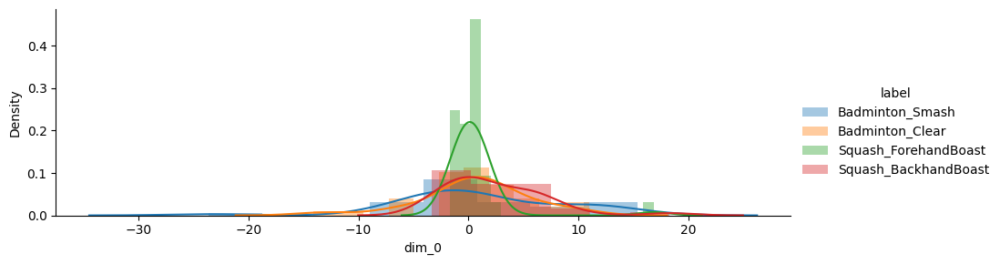

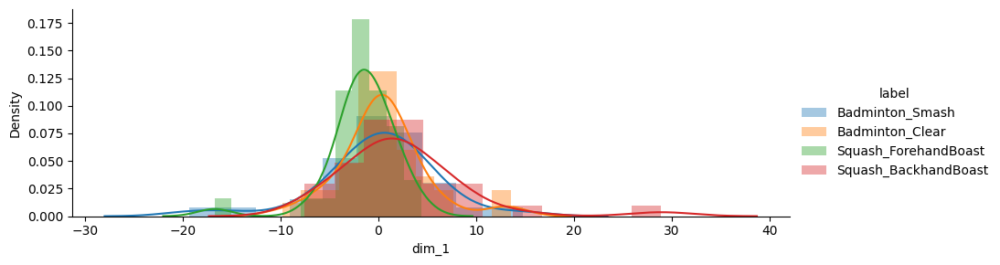

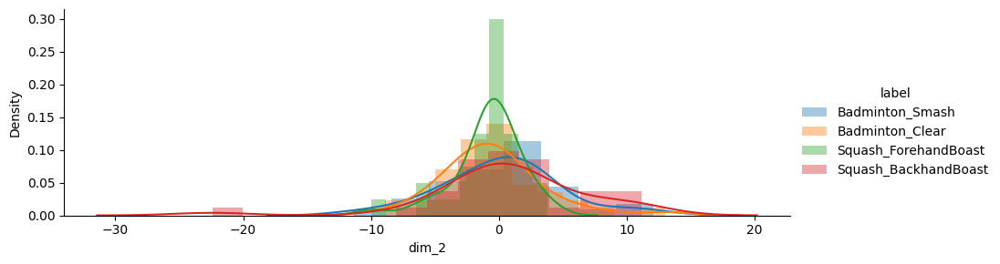

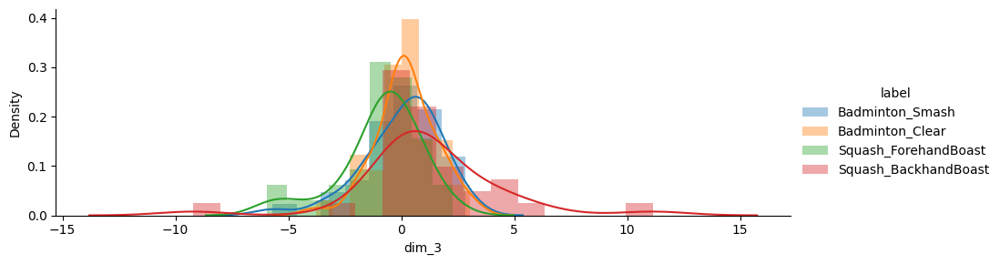

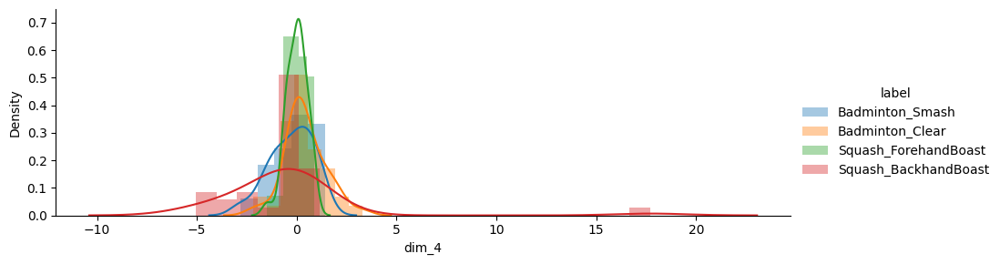

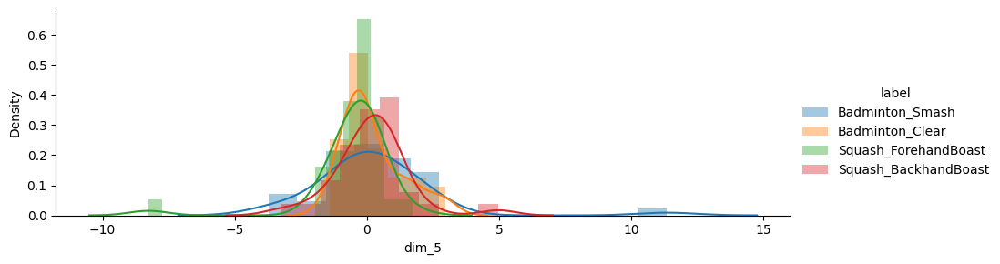

In [ ]:
# Extract data but for the time = 20 for the series of each axes.
data = X_train
  
i = 20
means = data.apply(lambda x: pd.Series([x["dim_0"][i],
                                          x["dim_1"][i],
                                          x["dim_2"][i],
                                          x["dim_3"][i],
                                          x["dim_4"][i],
                                          x["dim_5"][i],
                                          x["label"]], index=['dim_0', 'dim_1', 'dim_2', 'dim_3', 'dim_4', 'dim_5', "label"]), axis=1)

# Reset the index and drop the old index column
means = means.reset_index()
means = means.drop(['index'], axis=1)

# Plot the density plots using Seaborn FacetGrid
g = sns.FacetGrid(means, hue="label", aspect=3).map(sns.distplot, "dim_0").add_legend()
g = sns.FacetGrid(means, hue="label", aspect=3).map(sns.distplot, "dim_1").add_legend()
g = sns.FacetGrid(means, hue="label", aspect=3).map(sns.distplot, "dim_2").add_legend()
g = sns.FacetGrid(means, hue="label", aspect=3).map(sns.distplot, "dim_3").add_legend()
g = sns.FacetGrid(means, hue="label", aspect=3).map(sns.distplot, "dim_4").add_legend()
g = sns.FacetGrid(means, hue="label", aspect=3).map(sns.distplot, "dim_5").add_legend()

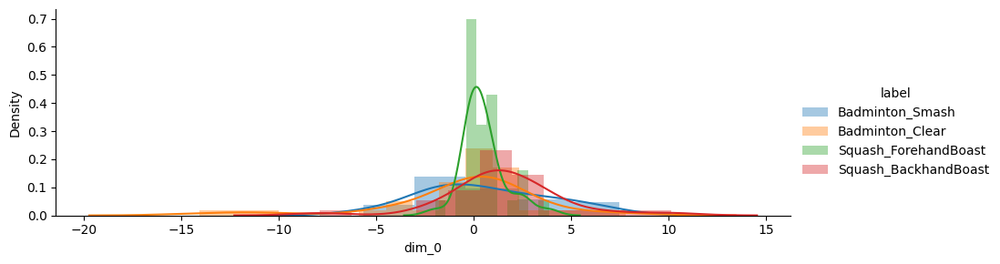

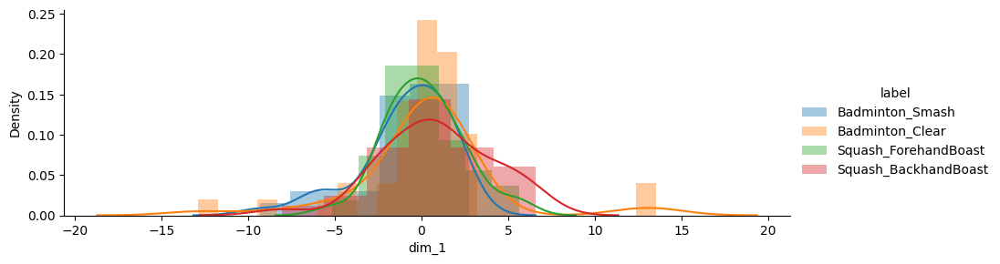

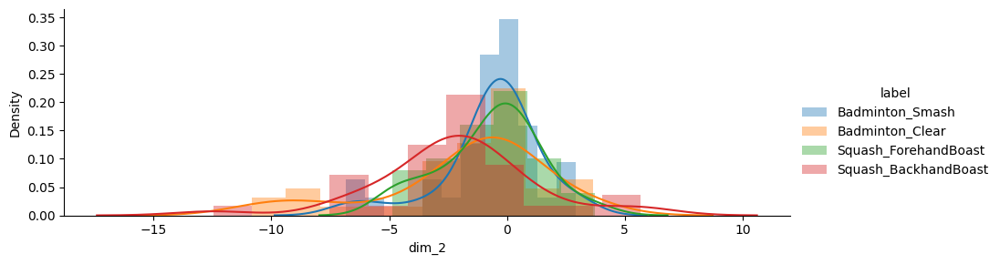

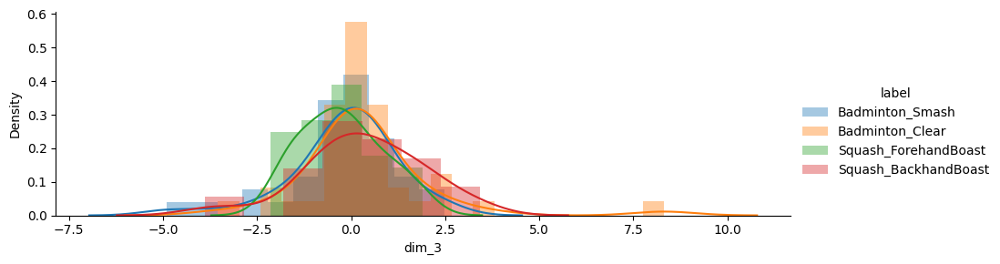

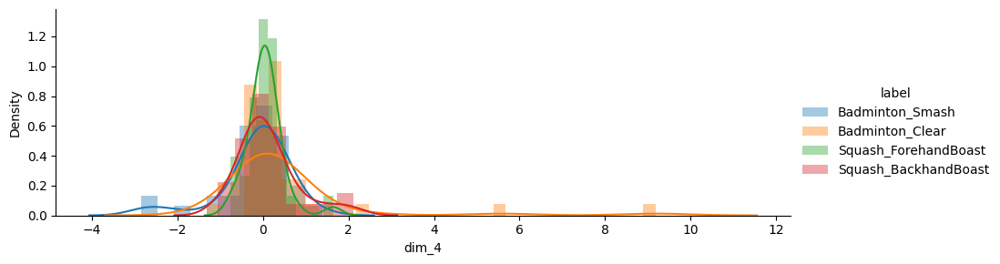

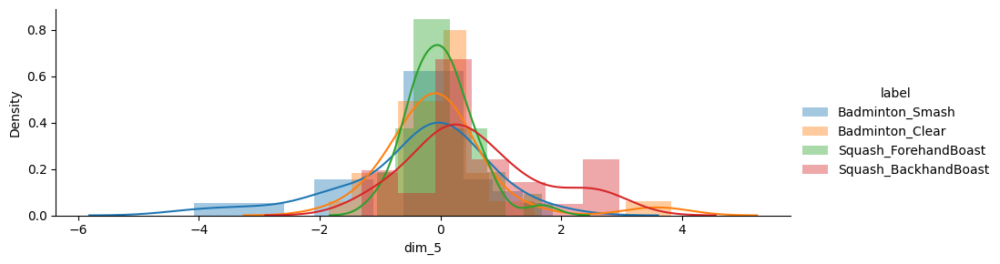

In [ ]:
# Extract data but for the time = 29 for the series of each axes.
data = X_train
  
i = 29
means = data.apply(lambda x: pd.Series([x["dim_0"][i],
                                          x["dim_1"][i],
                                          x["dim_2"][i],
                                          x["dim_3"][i],
                                          x["dim_4"][i],
                                          x["dim_5"][i],
                                          x["label"]], index=['dim_0', 'dim_1', 'dim_2', 'dim_3', 'dim_4', 'dim_5', "label"]), axis=1)

# Reset the index and drop the old index column
means = means.reset_index()
means = means.drop(['index'], axis=1)

# Plot the density plots using Seaborn FacetGrid
g = sns.FacetGrid(means, hue="label", aspect=3).map(sns.distplot, "dim_0").add_legend()
g = sns.FacetGrid(means, hue="label", aspect=3).map(sns.distplot, "dim_1").add_legend()
g = sns.FacetGrid(means, hue="label", aspect=3).map(sns.distplot, "dim_2").add_legend()
g = sns.FacetGrid(means, hue="label", aspect=3).map(sns.distplot, "dim_3").add_legend()
g = sns.FacetGrid(means, hue="label", aspect=3).map(sns.distplot, "dim_4").add_legend()
g = sns.FacetGrid(means, hue="label", aspect=3).map(sns.distplot, "dim_5").add_legend()

# Extragere manuala a atributelor și utilizarea algoritmilor clasici de Învățare Automată [4p]

## 1. Extragerea atributelor [2p]

In [ ]:
# Standardize the time series data.
for feature in ["dim_0", "dim_1", "dim_2", "dim_3", "dim_4", "dim_5"]:

  # Calculate the mean and standard deviation of the feature
  mean = X_train[feature].apply(lambda x: np.mean(x)).mean()
  std = X_train[feature].apply(lambda x: np.std(x)).mean()

  X_train[feature] = ( X_train[feature] - mean ) / std

  # Calculate the same but for X_test. 
  mean = X_test[feature].apply(lambda x: np.mean(x)).mean()
  std = X_test[feature].apply(lambda x: np.std(x)).mean()

  X_test[feature] = ( X_test[feature] - mean ) / std

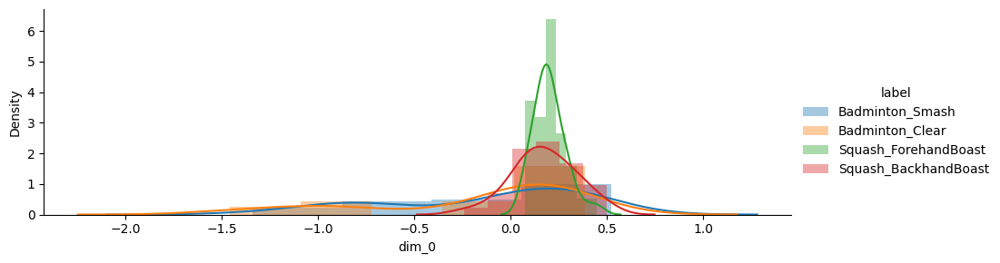

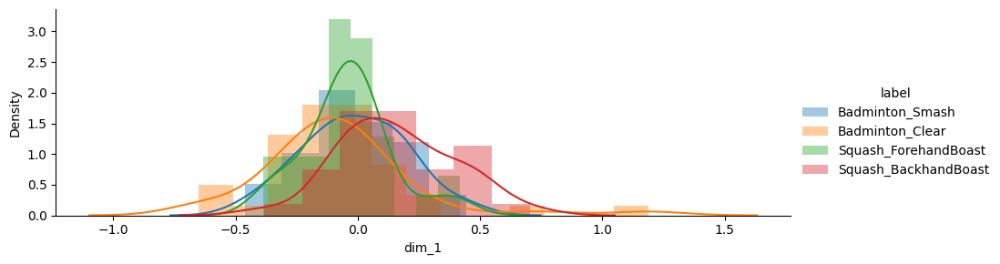

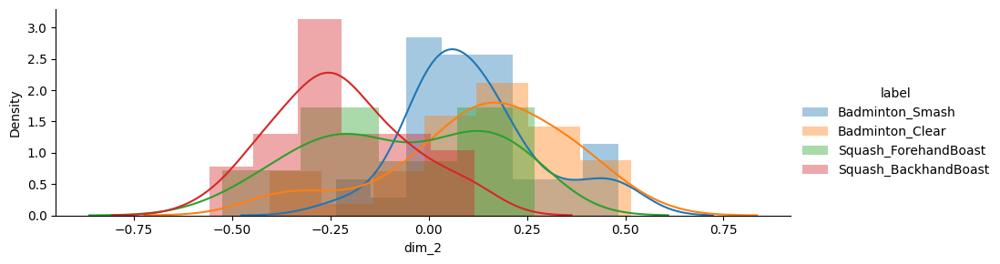

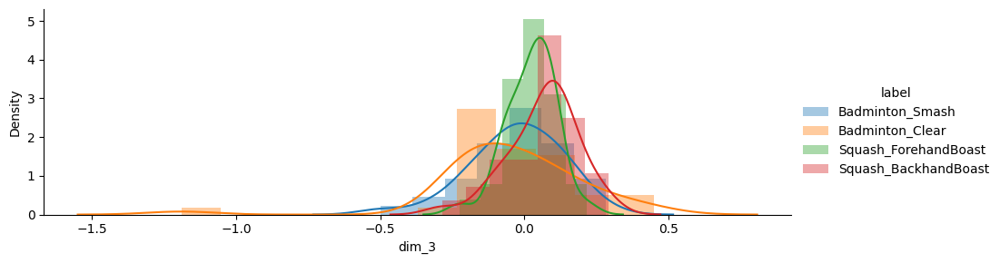

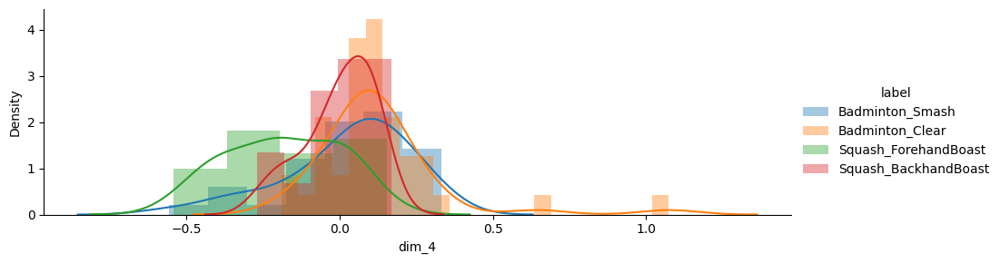

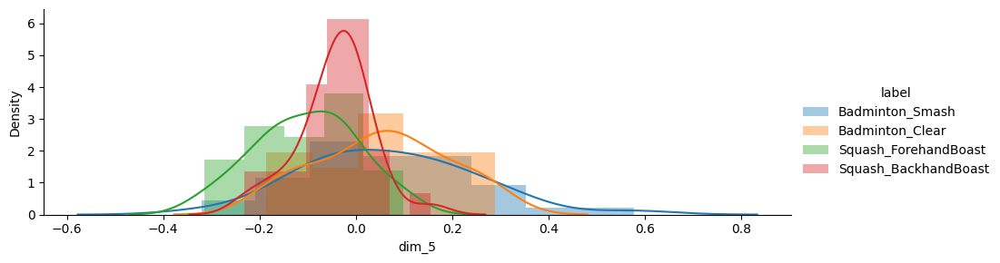

In [ ]:
# Create a new dataframe called "means" that contains the mean values for each feature in the training data,
# as well as the corresponding label

## !! Let's see the standardized data.

data = X_train  
means = data.apply(lambda x: pd.Series([x["dim_0"].mean(),
                                          x["dim_1"].mean(),
                                          x["dim_2"].mean(),
                                          x["dim_3"].mean(),
                                          x["dim_4"].mean(),
                                          x["dim_5"].mean(),
                                          x["label"]], index=['dim_0', 'dim_1', 'dim_2', 'dim_3', 'dim_4', 'dim_5', "label"]), axis=1)

# Reset the index and drop the old index column
means = means.reset_index()
means = means.drop(['index'], axis=1)

# Plot the density plots using Seaborn FacetGrid
g = sns.FacetGrid(means, hue="label", aspect=3).map(sns.distplot, "dim_0").add_legend()
g = sns.FacetGrid(means, hue="label", aspect=3).map(sns.distplot, "dim_1").add_legend()
g = sns.FacetGrid(means, hue="label", aspect=3).map(sns.distplot, "dim_2").add_legend()
g = sns.FacetGrid(means, hue="label", aspect=3).map(sns.distplot, "dim_3").add_legend()
g = sns.FacetGrid(means, hue="label", aspect=3).map(sns.distplot, "dim_4").add_legend()
g = sns.FacetGrid(means, hue="label", aspect=3).map(sns.distplot, "dim_5").add_legend()

In [ ]:
# Normalize the time series data. ( center )

for feature in ["dim_0", "dim_1", "dim_2", "dim_3", "dim_4", "dim_5"]:
  
  # Calculate the min and max of the feature
  min = X_train[feature].apply(lambda x: np.min(x))
  max = X_train[feature].apply(lambda x: np.max(x))

  # Normalize
  X_std = (X_train[feature] - min) / (max - min)
  X_train[feature] = X_std * (max - min) + min
  
  # Calculate the same but for test. 
  min = X_test[feature].apply(lambda x: np.min(x))
  max = X_test[feature].apply(lambda x: np.max(x))

  X_std = (X_test[feature] - min) / (max - min)
  X_test[feature] = X_std * (max - min) + min

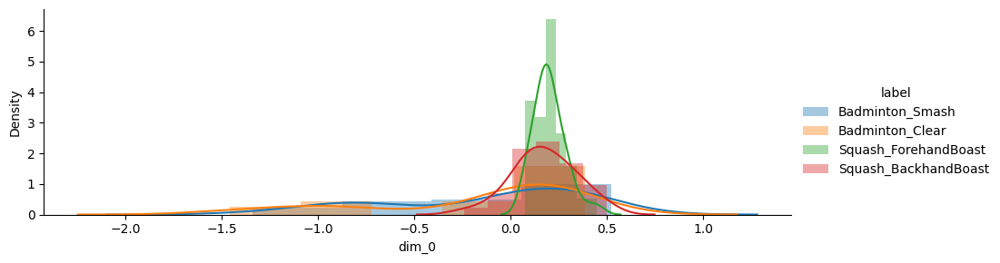

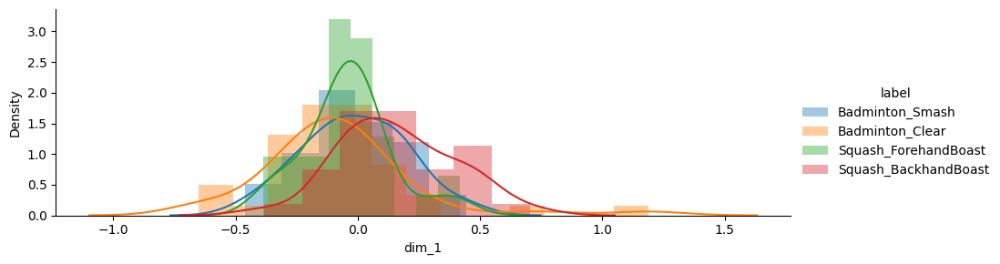

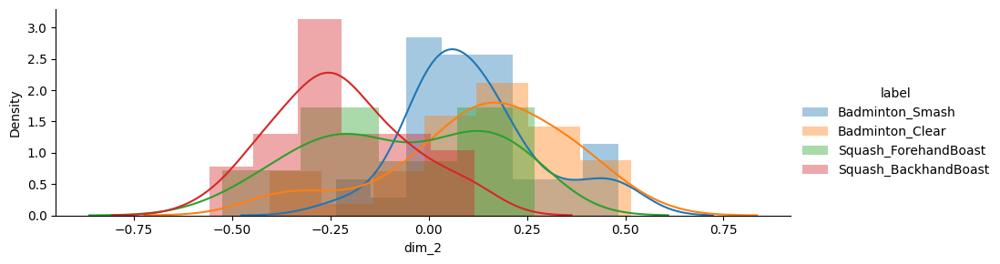

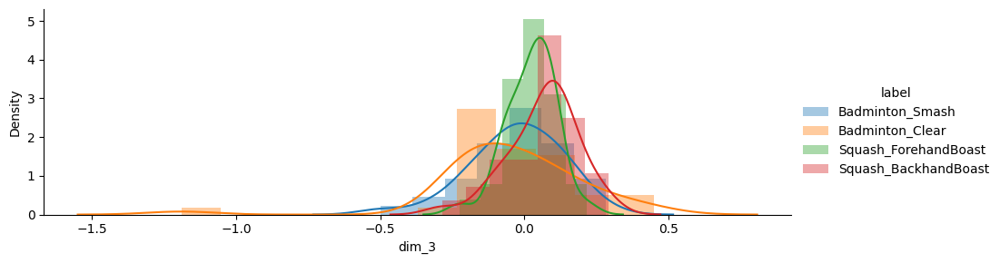

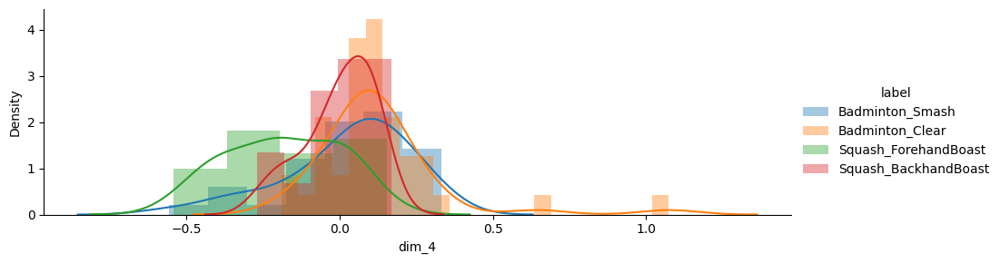

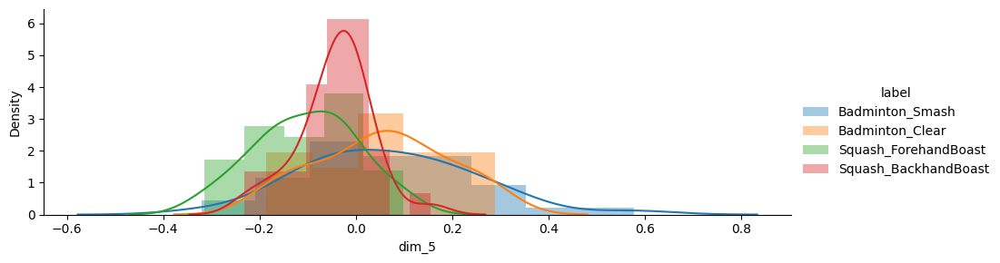

In [ ]:
# Create a new dataframe called "means" that contains the mean values for each feature in the training data,
# as well as the corresponding label

## !! Let's see the standardized-normalized - data.

data = X_train 
means = data.apply(lambda x: pd.Series([x["dim_0"].mean(),
                                          x["dim_1"].mean(),
                                          x["dim_2"].mean(),
                                          x["dim_3"].mean(),
                                          x["dim_4"].mean(),
                                          x["dim_5"].mean(),
                                          x["label"]], index=['dim_0', 'dim_1', 'dim_2', 'dim_3', 'dim_4', 'dim_5', "label"]), axis=1)

# Reset the index and drop the old index column
means = means.reset_index()
means = means.drop(['index'], axis=1)

# Plot the density plots using Seaborn FacetGrid
g = sns.FacetGrid(means, hue="label", aspect=3).map(sns.distplot, "dim_0").add_legend()
g = sns.FacetGrid(means, hue="label", aspect=3).map(sns.distplot, "dim_1").add_legend()
g = sns.FacetGrid(means, hue="label", aspect=3).map(sns.distplot, "dim_2").add_legend()
g = sns.FacetGrid(means, hue="label", aspect=3).map(sns.distplot, "dim_3").add_legend()
g = sns.FacetGrid(means, hue="label", aspect=3).map(sns.distplot, "dim_4").add_legend()
g = sns.FacetGrid(means, hue="label", aspect=3).map(sns.distplot, "dim_5").add_legend()

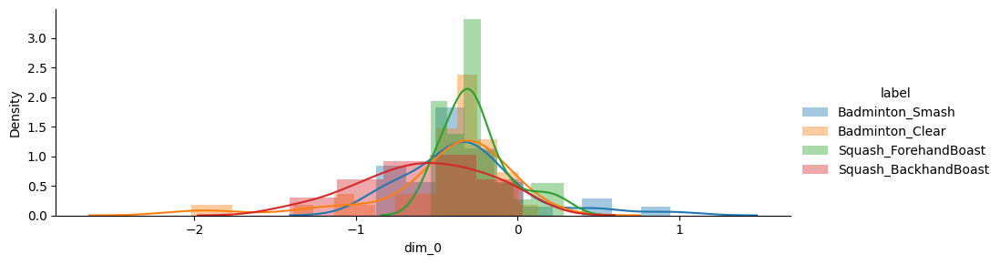

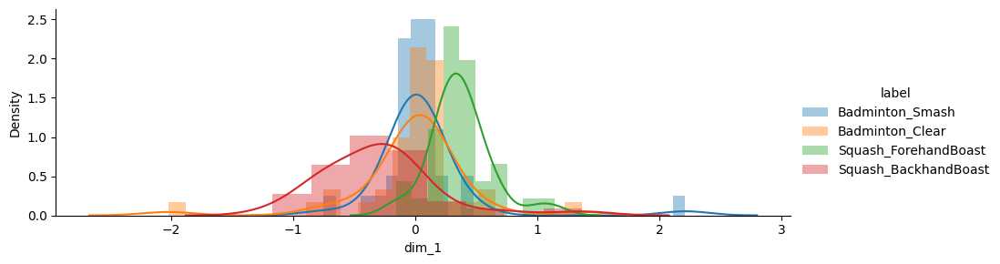

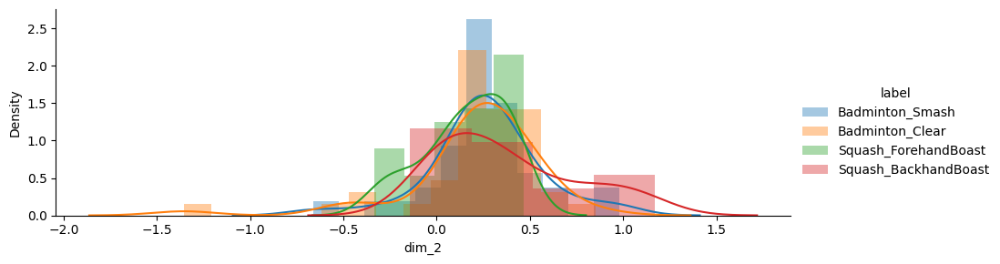

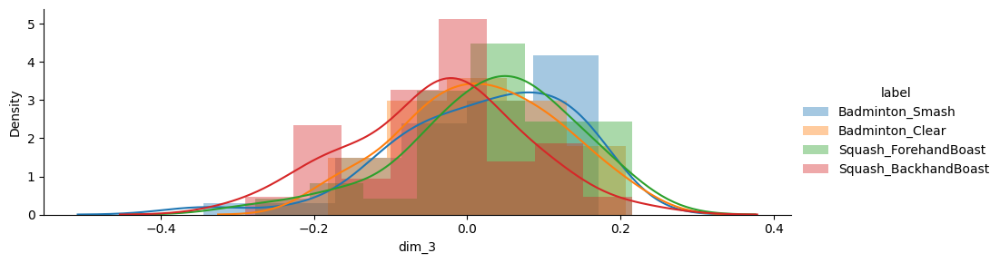

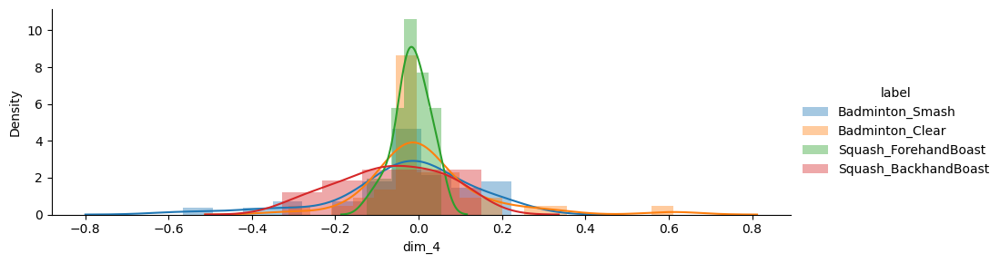

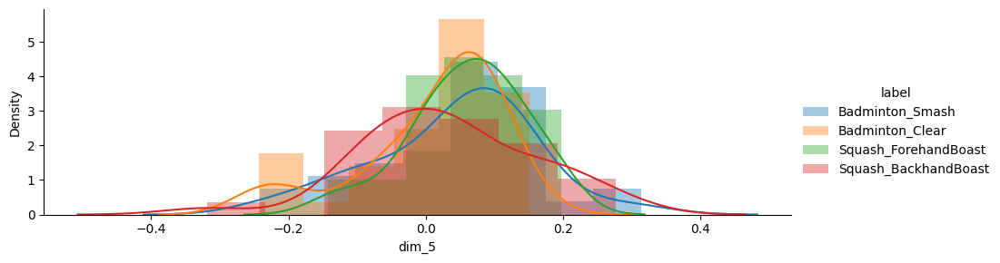

In [ ]:
# Extract data but for the time = 0 for the series of each axes.
data = X_train
  
i = 0
means = data.apply(lambda x: pd.Series([x["dim_0"][i],
                                          x["dim_1"][i],
                                          x["dim_2"][i],
                                          x["dim_3"][i],
                                          x["dim_4"][i],
                                          x["dim_5"][i],
                                          x["label"]], index=['dim_0', 'dim_1', 'dim_2', 'dim_3', 'dim_4', 'dim_5', "label"]), axis=1)

# Reset the index and drop the old index column
means = means.reset_index()
means = means.drop(['index'], axis=1)

# Plot the density plots using Seaborn FacetGrid
g = sns.FacetGrid(means, hue="label", aspect=3).map(sns.distplot, "dim_0").add_legend()
g = sns.FacetGrid(means, hue="label", aspect=3).map(sns.distplot, "dim_1").add_legend()
g = sns.FacetGrid(means, hue="label", aspect=3).map(sns.distplot, "dim_2").add_legend()
g = sns.FacetGrid(means, hue="label", aspect=3).map(sns.distplot, "dim_3").add_legend()
g = sns.FacetGrid(means, hue="label", aspect=3).map(sns.distplot, "dim_4").add_legend()
g = sns.FacetGrid(means, hue="label", aspect=3).map(sns.distplot, "dim_5").add_legend()

#### Feature Engineering

In [ ]:
X_train

,dim_0,dim_1,dim_2,dim_3,dim_4,dim_5,label
0,0 -0.221586 1 -0.715491 2 -0.538211 3...,0 0.070307 1 0.041766 2 -0.123755 3...,0 -0.378489 1 -0.141372 2 -0.313210 3...,0 0.135166 1 -0.288895 2 -0.199587 3...,0 0.022407 1 -0.428198 2 -0.376310 3...,0 0.157642 1 -0.195722 2 -0.216756 3...,Badminton_Smash
1,0 -0.336502 1 0.602286 2 -0.345531 3...,0 0.072423 1 -0.208034 2 -0.779960 3...,0 0.365775 1 0.394380 2 0.315411 3...,0 -0.030084 1 0.270647 2 0.417063 3...,0 -0.046549 1 0.155541 2 0.165099 3...,0 0.037049 1 -0.227272 2 -0.549086 3...,Badminton_Smash
2,0 -0.389553 1 -0.233149 2 0.131422 3...,0 -0.013262 1 0.371013 2 0.248617 3...,0 0.366342 1 0.384398 2 0.344235 3...,0 0.058616 1 0.049503 2 0.235410 3...,0 -0.007633 1 -0.217233 2 -0.095706 3...,0 0.084024 1 -0.080038 2 -0.152954 3...,Badminton_Smash
3,0 -0.580681 1 -0.577445 2 -0.433961 3...,0 0.003597 1 0.054487 2 0.015666 3...,0 0.275816 1 -0.013119 2 -0.157530 3...,0 0.142456 1 -0.084155 2 -0.008213 3...,0 -0.015143 1 -0.555870 2 -0.493741 3...,0 0.107862 1 -0.358382 2 -0.272144 3...,Badminton_Smash
4,0 -0.418548 1 0.309451 2 -0.233838 3...,0 0.154713 1 -0.417782 2 -0.463867 3...,0 0.412314 1 -0.214819 2 -0.770369 3...,0 0.062869 1 0.429214 2 0.393977 3...,0 0.000560 1 0.111163 2 0.005339 3...,0 0.006200 1 -0.166976 2 -0.162068 3...,Badminton_Smash
...,...,...,...,...,...,...,...
146,0 -0.357991 1 0.793106 2 2.659910 3...,0 -0.670905 1 0.451343 2 2.234263 3...,0 0.378173 1 1.202183 2 0.416279 3...,0 -0.090231 1 0.006368 2 1.159475 3...,0 0.040158 1 -0.223378 2 -0.886996 3...,0 0.041957 1 1.210020 2 0.440893 3...,Squash_BackhandBoast
147,0 -0.509509 1 0.915921 2 1.747773 3...,0 -0.913337 1 -0.537612 2 2.348019 3...,0 0.064049 1 -1.217620 2 -1.486962 3...,0 -0.219636 1 0.149139 2 -1.070189 3...,0 -0.206309 1 0.013532 2 -1.194227 3...,0 0.276832 1 0.731858 2 0.170963 3...,Squash_BackhandBoast
148,0 -0.271514 1 0.648011 2 0.795802 3...,0 -0.753416 1 -0.646790 2 -0.448544 3...,0 0.235244 1 -0.888181 2 -1.170471 3...,0 -0.052563 1 0.637600 2 0.170403 3...,0 -0.326471 1 0.508515 2 -0.015143 3...,0 -0.059705 1 0.914850 2 0.761305 3...,Squash_BackhandBoast
149,0 -0.033044 1 1.532476 2 1.532476 3...,0 -0.125707 1 2.914560 2 2.914560 3...,0 0.183941 1 -3.137980 2 -3.137980 3...,0 -0.158275 1 -2.223903 2 -2.223903 3...,0 -0.144180 1 -1.582704 2 -1.582704 3...,0 0.048267 1 -0.969757 2 -0.969757 3...,Squash_BackhandBoast


In [ ]:
# For each feature, compute a set of statistics and append them to the training and testing sets

for feature in ["dim_0", "dim_1", "dim_2", "dim_3", "dim_4", "dim_5"]:
  
  # Compute the mean
  X_train[feature + "_mean"] = X_train[feature].apply(lambda x: x.mean())
  X_test[feature + "_mean"] = X_test[feature].apply(lambda x: x.mean())

  # Compute the standard deviation
  X_train[feature + '_std'] = X_train[feature].apply(lambda x: x.std())
  X_test[feature + '_std'] = X_test[feature].apply(lambda x: x.std())

  # Compute the average absolute difference from the mean
  X_train[feature + '_aad'] = X_train[feature].apply(lambda x: np.mean(np.absolute(x - np.mean(x))))
  X_test[feature + '_aad'] = X_test[feature].apply(lambda x: np.mean(np.absolute(x - np.mean(x))))

  # Compute the minimum
  X_train[feature + '_min'] = X_train[feature].apply(lambda x: x.min())
  X_test[feature + '_min'] = X_test[feature].apply(lambda x: x.min())

  # Compute the maximum
  X_train[feature + '_max'] = X_train[feature].apply(lambda x: x.max())
  X_test[feature + '_max'] = X_test[feature].apply(lambda x: x.max())

  # Compute the difference between the maximum and minimum
  X_train[feature + '_maxmin_diff'] = X_train[feature + '_max'] - X_train[feature + '_min']
  X_test[feature + '_maxmin_diff'] = X_test[feature + '_max'] - X_test[feature + '_min']

  # Compute the median
  X_train[feature + '_median'] = X_train[feature].apply(lambda x: np.median(x))
  X_test[feature + '_median'] = X_test[feature].apply(lambda x: np.median(x))

  # Compute the median absolute deviation from the median
  X_train[feature + '_mad'] = X_train[feature].apply(lambda x: np.median(np.absolute(x - np.median(x))))
  X_test[feature + '_mad'] = X_test[feature].apply(lambda x: np.median(np.absolute(x - np.median(x))))

  # Compute the interquartile range
  X_train[feature + '_IQR'] = X_train[feature].apply(lambda x: np.percentile(x, 75) - np.percentile(x, 25))
  X_test[feature + '_IQR'] = X_test[feature].apply(lambda x: np.percentile(x, 75) - np.percentile(x, 25))

  # Compute the number of negative values
  X_train[feature + '_neg_count'] = X_train[feature].apply(lambda x: np.sum(x < 0))
  X_test[feature + '_neg_count'] = X_test[feature].apply(lambda x: np.sum(x < 0))

  # Compute the number of positive values
  X_train[feature + '_pos_count'] = X_train[feature].apply(lambda x: np.sum(x > 0))
  X_test[feature + '_pos_count'] = X_test[feature].apply(lambda x: np.sum(x > 0))

  # Compute the number of values above the mean
  X_train[feature + '_above_mean'] = X_train[feature].apply(lambda x: np.sum(x > x.mean()))
  X_test[feature + '_above_mean'] = X_test[feature].apply(lambda x: np.sum(x > x.mean()))

  # Compute the number of peaks
  X_train[feature + '_peak_count'] = X_train[feature].apply(lambda x: len(find_peaks(x)[0]))
  X_test[feature + '_peak_count'] = X_test[feature].apply(lambda x: len(find_peaks(x)[0]))

  # Compute the skewness
  X_train[feature + '_skewness'] = X_train[feature].apply(lambda x: skew(x))
  X_test[feature + '_skewness'] = X_test[feature].apply(lambda x: skew(x))

  # Compute the kurtosis
  X_train[feature + '_kurtosis'] = X_train[feature].apply(lambda x: kurtosis(x))
  X_test[feature + '_kurtosis'] = X_test[feature].apply(lambda x: kurtosis(x))

X_train

,dim_0,dim_1,dim_2,dim_3,dim_4,dim_5,label,dim_0_mean,dim_0_std,dim_0_aad,...,dim_5_maxmin_diff,dim_5_median,dim_5_mad,dim_5_IQR,dim_5_neg_count,dim_5_pos_count,dim_5_above_mean,dim_5_peak_count,dim_5_skewness,dim_5_kurtosis
0,0 -0.221586 1 -0.715491 2 -0.538211 3...,0 0.070307 1 0.041766 2 -0.123755 3...,0 -0.378489 1 -0.141372 2 -0.313210 3...,0 0.135166 1 -0.288895 2 -0.199587 3...,0 0.022407 1 -0.428198 2 -0.376310 3...,0 0.157642 1 -0.195722 2 -0.216756 3...,Badminton_Smash,-0.780353,0.841377,0.533942,...,3.202709,0.087880,0.095002,0.241710,6,24,9,6,1.557490,3.845008
1,0 -0.336502 1 0.602286 2 -0.345531 3...,0 0.072423 1 -0.208034 2 -0.779960 3...,0 0.365775 1 0.394380 2 0.315411 3...,0 -0.030084 1 0.270647 2 0.417063 3...,0 -0.046549 1 0.155541 2 0.165099 3...,0 0.037049 1 -0.227272 2 -0.549086 3...,Badminton_Smash,-0.065169,1.471577,1.178671,...,11.205975,0.017418,0.509012,0.919692,15,15,16,4,-1.212967,9.231045
2,0 -0.389553 1 -0.233149 2 0.131422 3...,0 -0.013262 1 0.371013 2 0.248617 3...,0 0.366342 1 0.384398 2 0.344235 3...,0 0.058616 1 0.049503 2 0.235410 3...,0 -0.007633 1 -0.217233 2 -0.095706 3...,0 0.084024 1 -0.080038 2 -0.152954 3...,Badminton_Smash,0.308471,0.979026,0.723246,...,4.113462,-0.017287,0.135667,0.236102,15,15,15,7,-1.969071,8.574850
3,0 -0.580681 1 -0.577445 2 -0.433961 3...,0 0.003597 1 0.054487 2 0.015666 3...,0 0.275816 1 -0.013119 2 -0.157530 3...,0 0.142456 1 -0.084155 2 -0.008213 3...,0 -0.015143 1 -0.555870 2 -0.493741 3...,0 0.107862 1 -0.358382 2 -0.272144 3...,Badminton_Smash,-1.003233,1.250998,0.881918,...,6.889189,0.016717,0.133563,0.263270,14,16,16,6,-0.601665,4.796229
4,0 -0.418548 1 0.309451 2 -0.233838 3...,0 0.154713 1 -0.417782 2 -0.463867 3...,0 0.412314 1 -0.214819 2 -0.770369 3...,0 0.062869 1 0.429214 2 0.393977 3...,0 0.000560 1 0.111163 2 0.005339 3...,0 0.006200 1 -0.166976 2 -0.162068 3...,Badminton_Smash,0.025409,1.193008,0.882691,...,7.421338,0.137660,0.302182,0.751599,10,20,12,7,2.695009,12.211957
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
146,0 -0.357991 1 0.793106 2 2.659910 3...,0 -0.670905 1 0.451343 2 2.234263 3...,0 0.378173 1 1.202183 2 0.416279 3...,0 -0.090231 1 0.006368 2 1.159475 3...,0 0.040158 1 -0.223378 2 -0.886996 3...,0 0.041957 1 1.210020 2 0.440893 3...,Squash_BackhandBoast,0.165624,0.946073,0.728287,...,3.267913,0.095943,0.112530,0.207706,7,23,23,5,-2.244548,6.192921
147,0 -0.509509 1 0.915921 2 1.747773 3...,0 -0.913337 1 -0.537612 2 2.348019 3...,0 0.064049 1 -1.217620 2 -1.486962 3...,0 -0.219636 1 0.149139 2 -1.070189 3...,0 -0.206309 1 0.013532 2 -1.194227 3...,0 0.276832 1 0.731858 2 0.170963 3...,Squash_BackhandBoast,0.286472,0.896308,0.797850,...,4.982848,0.171313,0.288861,0.546522,11,19,19,6,-2.998682,9.630878
148,0 -0.271514 1 0.648011 2 0.795802 3...,0 -0.753416 1 -0.646790 2 -0.448544 3...,0 0.235244 1 -0.888181 2 -1.170471 3...,0 -0.052563 1 0.637600 2 0.170403 3...,0 -0.326471 1 0.508515 2 -0.015143 3...,0 -0.059705 1 0.914850 2 0.761305 3...,Squash_BackhandBoast,0.386046,0.965329,0.782765,...,4.167448,0.055278,0.120592,0.266600,14,16,20,7,-2.787552,7.786997
149,0 -0.033044 1 1.532476 2 1.532476 3...,0 -0.125707 1 2.914560 2 2.914560 3...,0 0.183941 1 -3.137980 2 -3.137980 3...,0 -0.158275 1 -2.223903 2 -2.223903 3...,0 -0.144180 1 -1.582704 2 -1.582704 3...,0 0.048267 1 -0.969757 2 -0.969757 3...,Squash_BackhandBoast,0.065306,0.844349,0.634010,...,5.667140,0.088932,0.371242,0.697613,14,16,16,4,-2.462948,7.943839


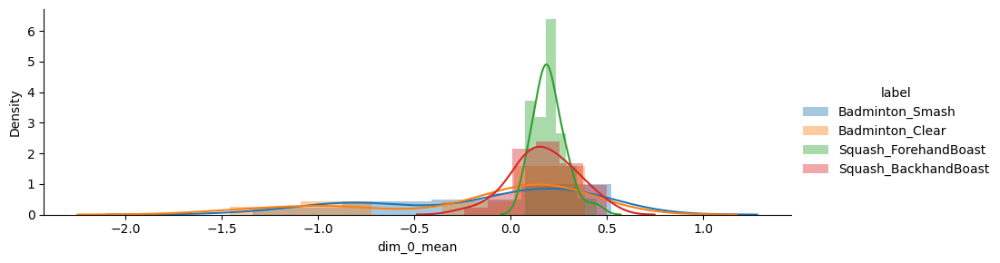

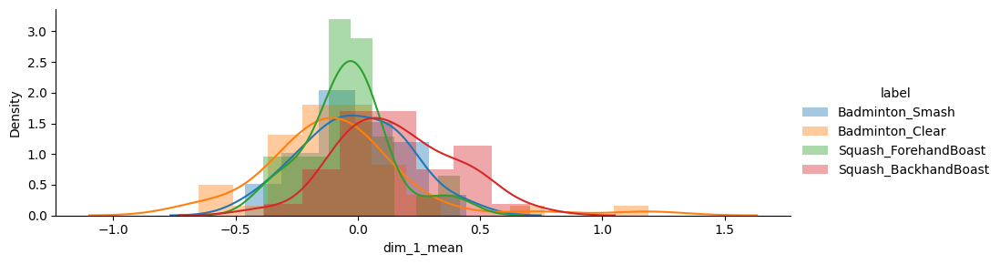

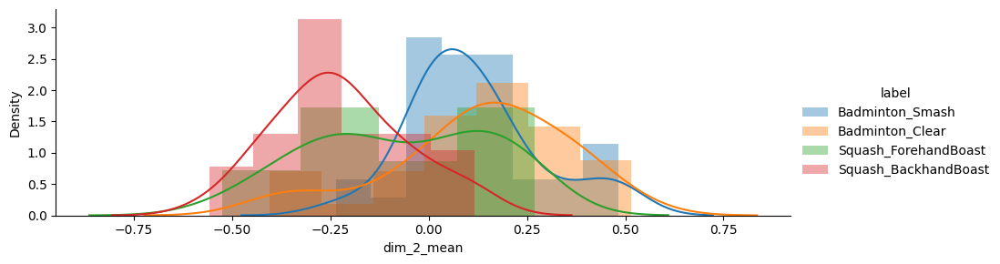

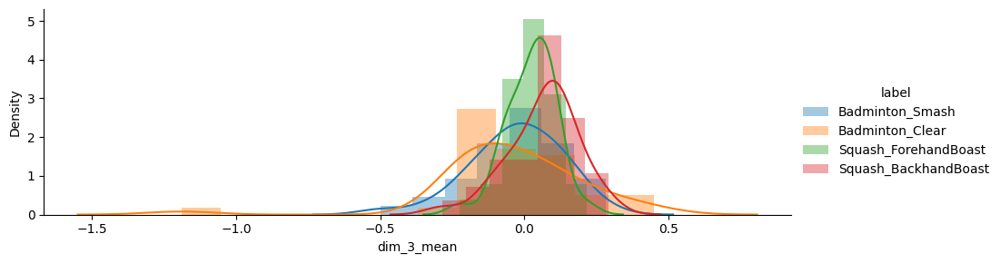

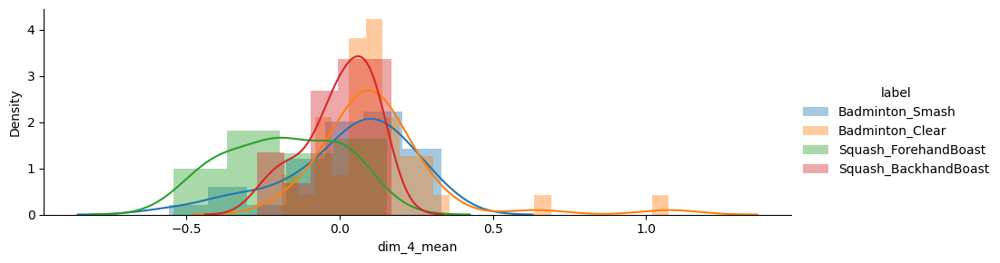

...

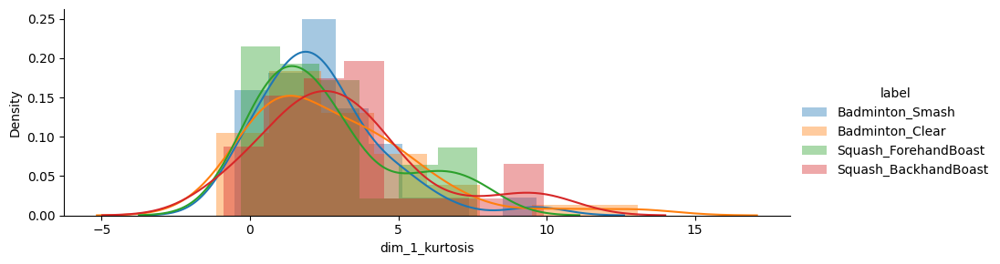

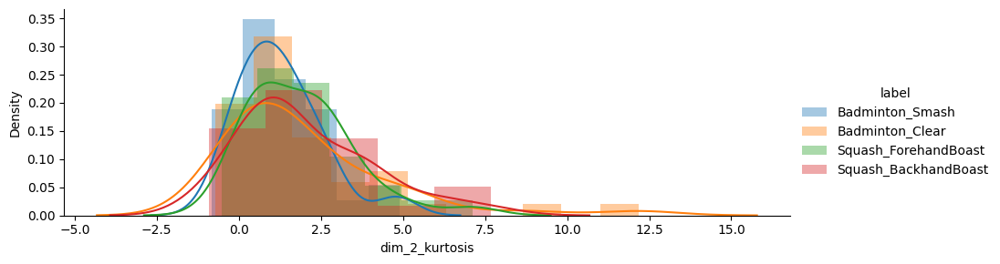

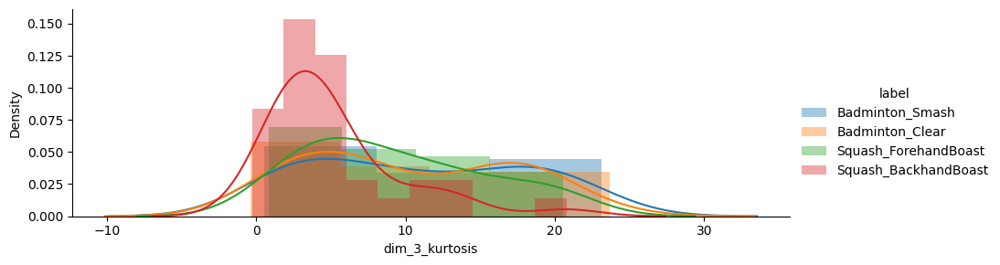

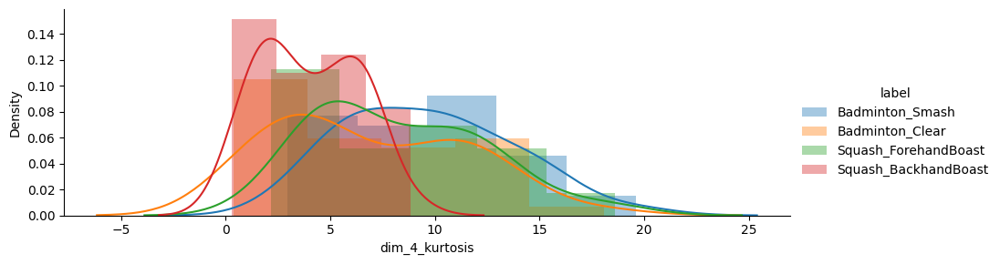

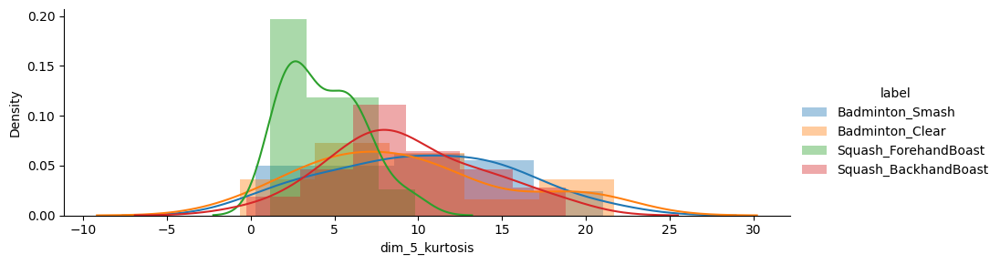

In [ ]:
# Select data to be analyzed
data = X_train

# List of features to be analyzed
columns_features = ["mean", "std", "aad", "min", "max", "maxmin_diff", "median", "mad", "IQR", "neg_count", "pos_count", "above_mean", "peak_count", "skewness","kurtosis"];

for feature_to_verify in columns_features:
  
  # Create column names for each dimension of the feature
  dim_0 = "dim_0" + "_" + feature_to_verify;
  dim_1 = "dim_1" + "_" + feature_to_verify;
  dim_2 = "dim_2" + "_" + feature_to_verify;
  dim_3 = "dim_3" + "_" + feature_to_verify;
  dim_4 = "dim_4" + "_" + feature_to_verify;
  dim_5 = "dim_5" + "_" + feature_to_verify;

  # Apply a lambda function to obtain means of each feature's dimension and label
  means = data.apply(lambda x: pd.Series([x[dim_0],
                                            x[dim_1],
                                            x[dim_2],
                                            x[dim_3],
                                            x[dim_4],
                                            x[dim_5],
                                            x["label"]], index=[dim_0, dim_1, dim_2, dim_3, dim_4, dim_5, "label"]), axis=1)
  
  # Reset index and drop original index
  means = means.reset_index()
  means = means.drop(['index'], axis=1)

  # Plot distribution plots of means for each dimension of the feature
  g = sns.FacetGrid(means, hue="label", aspect=3).map(sns.distplot, dim_0).add_legend()
  g = sns.FacetGrid(means, hue="label", aspect=3).map(sns.distplot, dim_1).add_legend()
  g = sns.FacetGrid(means, hue="label", aspect=3).map(sns.distplot, dim_2).add_legend()
  g = sns.FacetGrid(means, hue="label", aspect=3).map(sns.distplot, dim_3).add_legend()
  g = sns.FacetGrid(means, hue="label", aspect=3).map(sns.distplot, dim_4).add_legend()
  g = sns.FacetGrid(means, hue="label", aspect=3).map(sns.distplot, dim_5).add_legend()

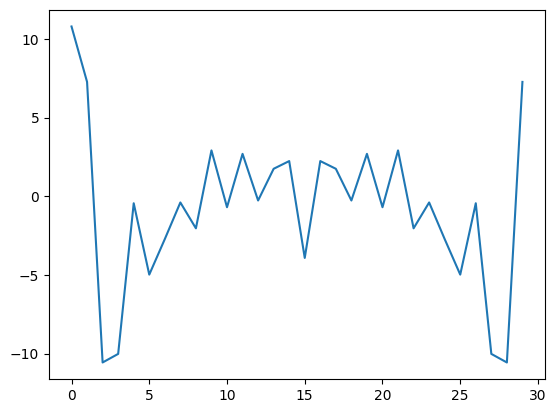

In [ ]:
# Plot the Fast Fourier Transform of a specific column in the training set

pd.Series(np.fft.fft(X_train["dim_0"][20])).plot()
plt.show()

In [ ]:
# Looping over each feature and performing FFT and statistical feature extraction on the transformed data
for feature in ["dim_0", "dim_1", "dim_2", "dim_3", "dim_4", "dim_5"]:
  
  # Convert the signals from time domain to frequency domain using Fast Fourier Transform (FFT)  
  x_list_fft = X_train[feature].apply(lambda x: np.abs(np.fft.fft(x))[1:])
  x_test_list_fft = X_test[feature].apply(lambda x: np.abs(np.fft.fft(x))[1:])

  # Compute statistical features on the raw signals in frequency domain
  # Mean of the FFT
  X_train[feature + '_mean_fft'] = pd.Series(x_list_fft).apply(lambda x: x.mean())
  X_test[feature + '_mean_fft'] = pd.Series(x_test_list_fft).apply(lambda x: x.mean())

  # Standard deviation of the FFT
  X_train[feature + '_std_fft'] = pd.Series(x_list_fft).apply(lambda x: x.std())
  X_test[feature + '_std_fft'] = pd.Series(x_test_list_fft).apply(lambda x: x.std())

  # Average absolute difference of the FFT
  X_train[feature + '_aad_fft'] = pd.Series(x_list_fft).apply(lambda x: np.mean(np.absolute(x - np.mean(x))))
  X_test[feature + '_aad_fft'] = pd.Series(x_test_list_fft).apply(lambda x: np.mean(np.absolute(x - np.mean(x))))

  # Minimum value of the FFT
  X_train[feature + '_min_fft'] = pd.Series(x_list_fft).apply(lambda x: x.min())
  X_test[feature + '_min_fft'] = pd.Series(x_test_list_fft).apply(lambda x: x.min())

  # Maximum value of the FFT
  X_train[feature + '_max_fft'] = pd.Series(x_list_fft).apply(lambda x: x.max())
  X_test[feature + '_max_fft'] = pd.Series(x_test_list_fft).apply(lambda x: x.max())

  # Maximum-minimum difference of the FFT
  X_train[feature + '_maxmin_diff_fft'] = X_train[feature + '_max_fft'] - X_train[feature + '_min_fft']
  X_test[feature + '_maxmin_diff_fft'] = X_test[feature + '_max_fft'] - X_test[feature + '_min_fft']

  # Median of the FFT
  X_train[feature + '_median_fft'] = pd.Series(x_list_fft).apply(lambda x: np.median(x))
  X_test[feature + '_median_fft'] = pd.Series(x_test_list_fft).apply(lambda x: np.median(x))

  # Median absolute deviation of the FFT
  X_train[feature + '_mad_fft'] = pd.Series(x_list_fft).apply(lambda x: np.median(np.absolute(x - np.median(x))))
  X_test[feature + '_mad_fft'] = pd.Series(x_test_list_fft).apply(lambda x: np.median(np.absolute(x - np.median(x))))

  # Interquartile range of the FFT
  X_train[feature + '_IQR_fft'] = pd.Series(x_list_fft).apply(lambda x: np.percentile(x, 75) - np.percentile(x, 25))
  X_test[feature + '_IQR_fft'] = pd.Series(x_test_list_fft).apply(lambda x: np.percentile(x, 75) - np.percentile(x, 25))

  # Number of values in the FFT that are above the mean
  X_train[feature + '_above_mean_fft'] = pd.Series(x_list_fft).apply(lambda x: np.sum(x > x.mean()))
  X_test[feature + '_above_mean_fft'] = pd.Series(x_test_list_fft).apply(lambda x: np.sum(x > x.mean()))

  # Calculate the number of peaks in the FFT of the signal
  X_train[feature + '_peak_count_fft'] = pd.Series(x_list_fft).apply(lambda x: len(find_peaks(x)[0]))
  X_test[feature + '_peak_count_fft'] = pd.Series(x_test_list_fft).apply(lambda x: len(find_peaks(x)[0]))

  # Calculate the skewness of the FFT signal
  X_train[feature + '_skewness_fft'] = pd.Series(x_list_fft).apply(lambda x: skew(x))
  X_test[feature + '_skewness_fft'] = pd.Series(x_test_list_fft).apply(lambda x: skew(x))

  # Calculate the kurtosis of the FFT signal
  X_train[feature + '_kurtosis_fft'] = pd.Series(x_list_fft).apply(lambda x: kurtosis(x))
  X_test[feature + '_kurtosis_fft'] = pd.Series(x_test_list_fft).apply(lambda x: kurtosis(x))

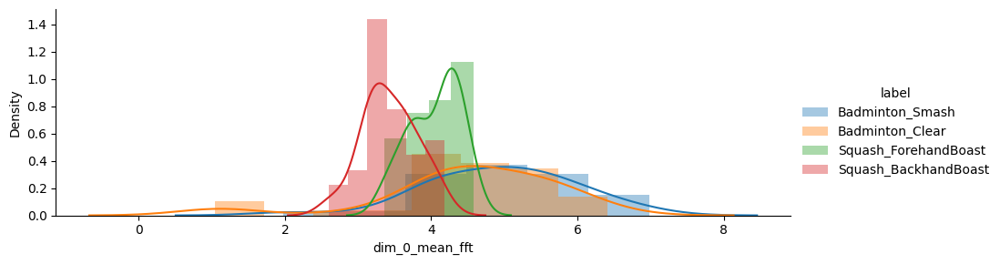

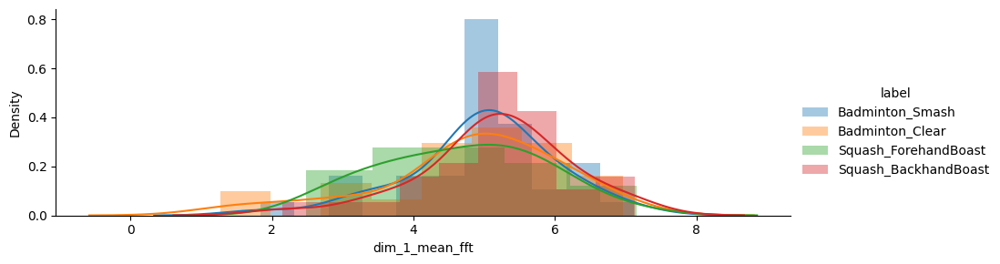

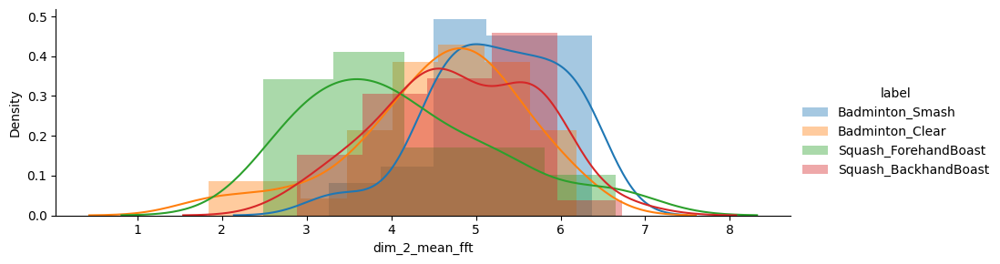

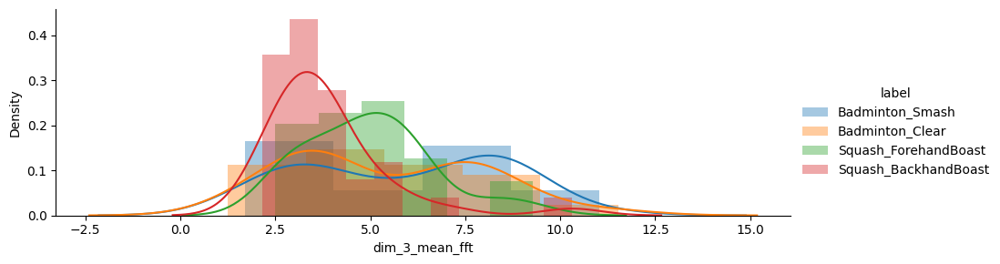

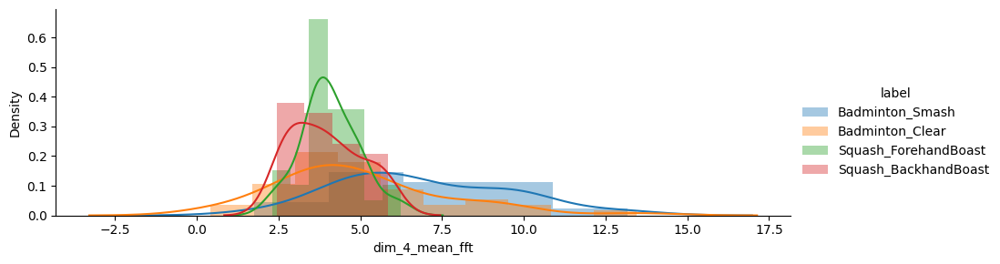

...

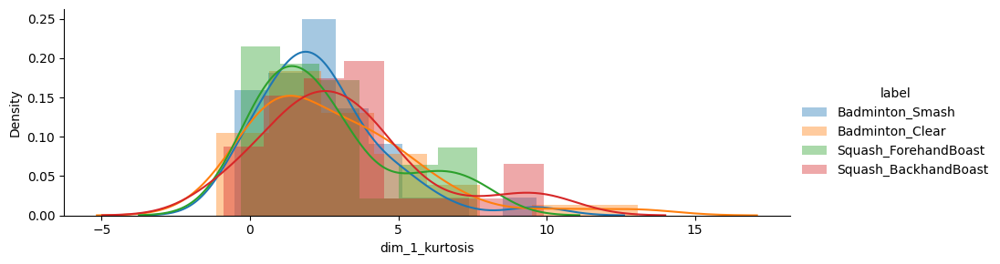

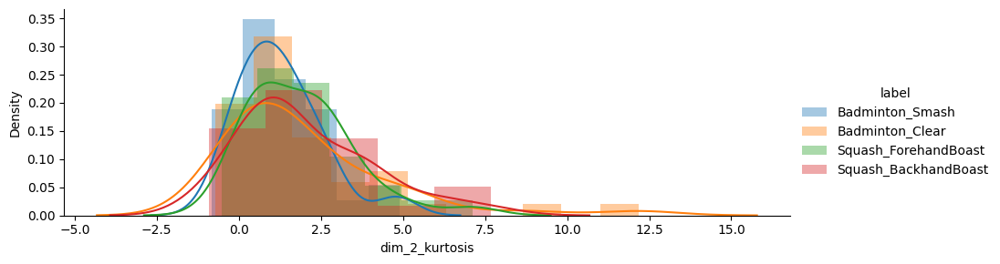

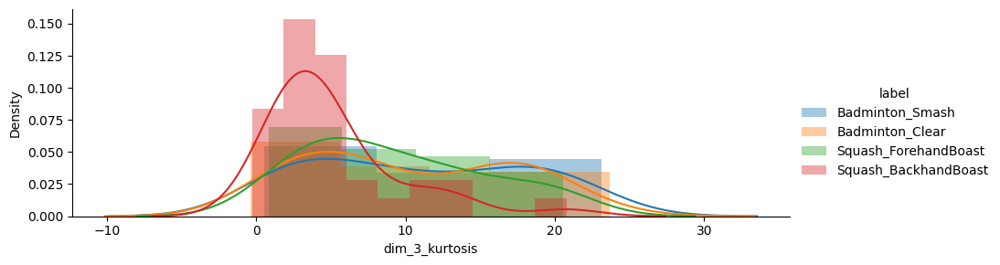

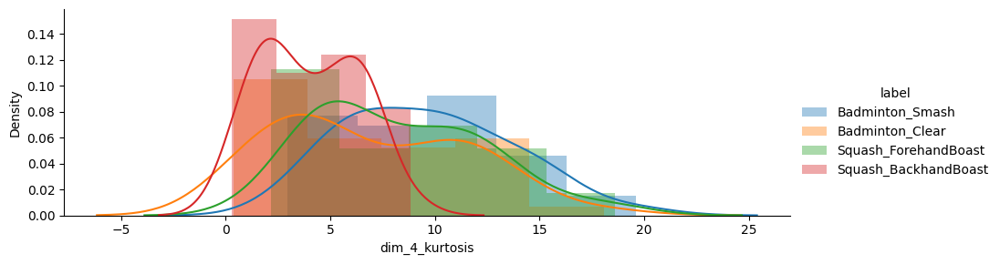

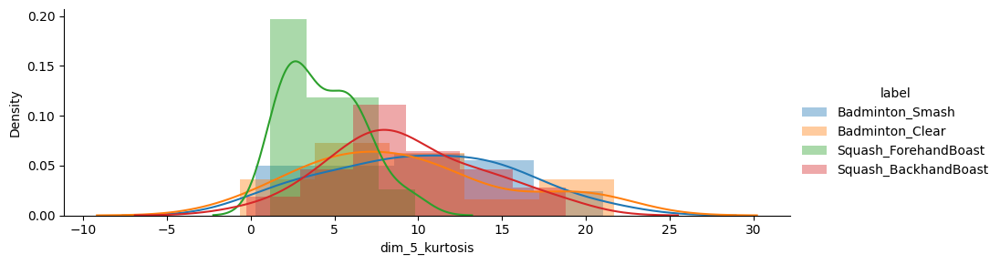

In [ ]:
data = X_train

# Define the new list of features
columns_features = ["mean_fft", "std_fft", "aad_fft", "min_fft", "max_fft", "maxmin_diff_fft", "median_fft", "mad_fft", "IQR_fft", "above_mean_fft", "peak_count_fft", "skewness_fft", "kurtosis_fft",
                    "mean", "std", "aad", "min", "max", "maxmin_diff", "median", "mad", "IQR", "neg_count", "pos_count", "above_mean", "peak_count", "skewness","kurtosis"];


for feature_to_verify in columns_features:

  # Create column names for each dimension of the feature
  dim_0 = "dim_0" + "_" + feature_to_verify;
  dim_1 = "dim_1" + "_" + feature_to_verify;
  dim_2 = "dim_2" + "_" + feature_to_verify;
  dim_3 = "dim_3" + "_" + feature_to_verify;
  dim_4 = "dim_4" + "_" + feature_to_verify;
  dim_5 = "dim_5" + "_" + feature_to_verify;

  # Apply a lambda function to obtain means of each feature's dimension and label
  means = data.apply(lambda x: pd.Series([x[dim_0],
                                            x[dim_1],
                                            x[dim_2],
                                            x[dim_3],
                                            x[dim_4],
                                            x[dim_5],
                                            x["label"]], index=[dim_0, dim_1, dim_2, dim_3, dim_4, dim_5, "label"]), axis=1)
  # Reset index and drop original index
  means = means.reset_index()
  means = means.drop(['index'], axis=1)

  # Plot distribution plots of means for each dimension of the feature
  g = sns.FacetGrid(means, hue="label", aspect=3).map(sns.distplot, dim_0).add_legend()
  g = sns.FacetGrid(means, hue="label", aspect=3).map(sns.distplot, dim_1).add_legend()
  g = sns.FacetGrid(means, hue="label", aspect=3).map(sns.distplot, dim_2).add_legend()
  g = sns.FacetGrid(means, hue="label", aspect=3).map(sns.distplot, dim_3).add_legend()
  g = sns.FacetGrid(means, hue="label", aspect=3).map(sns.distplot, dim_4).add_legend()
  g = sns.FacetGrid(means, hue="label", aspect=3).map(sns.distplot, dim_5).add_legend()

In [ ]:
X = X_train
X

,dim_0,dim_1,dim_2,dim_3,dim_4,dim_5,label,dim_0_mean,dim_0_std,dim_0_aad,...,dim_5_min_fft,dim_5_max_fft,dim_5_maxmin_diff_fft,dim_5_median_fft,dim_5_mad_fft,dim_5_IQR_fft,dim_5_above_mean_fft,dim_5_peak_count_fft,dim_5_skewness_fft,dim_5_kurtosis_fft
0,0 -0.221586 1 -0.715491 2 -0.538211 3...,0 0.070307 1 0.041766 2 -0.123755 3...,0 -0.378489 1 -0.141372 2 -0.313210 3...,0 0.135166 1 -0.288895 2 -0.199587 3...,0 0.022407 1 -0.428198 2 -0.376310 3...,0 0.157642 1 -0.195722 2 -0.216756 3...,Badminton_Smash,-0.780353,0.841377,0.533942,...,1.265895,5.222531,3.956636,2.738496,0.554814,0.744885,14,8,0.508687,1.087508
1,0 -0.336502 1 0.602286 2 -0.345531 3...,0 0.072423 1 -0.208034 2 -0.779960 3...,0 0.365775 1 0.394380 2 0.315411 3...,0 -0.030084 1 0.270647 2 0.417063 3...,0 -0.046549 1 0.155541 2 0.165099 3...,0 0.037049 1 -0.227272 2 -0.549086 3...,Badminton_Smash,-0.065169,1.471577,1.178671,...,2.358359,12.252228,9.893870,9.560039,2.476791,6.711256,15,9,-0.288644,-1.521324
2,0 -0.389553 1 -0.233149 2 0.131422 3...,0 -0.013262 1 0.371013 2 0.248617 3...,0 0.366342 1 0.384398 2 0.344235 3...,0 0.058616 1 0.049503 2 0.235410 3...,0 -0.007633 1 -0.217233 2 -0.095706 3...,0 0.084024 1 -0.080038 2 -0.152954 3...,Badminton_Smash,0.308471,0.979026,0.723246,...,1.223377,5.050214,3.826837,3.424648,0.716158,1.625351,15,8,-0.343930,-0.631650
3,0 -0.580681 1 -0.577445 2 -0.433961 3...,0 0.003597 1 0.054487 2 0.015666 3...,0 0.275816 1 -0.013119 2 -0.157530 3...,0 0.142456 1 -0.084155 2 -0.008213 3...,0 -0.015143 1 -0.555870 2 -0.493741 3...,0 0.107862 1 -0.358382 2 -0.272144 3...,Badminton_Smash,-1.003233,1.250998,0.881918,...,2.078744,8.775565,6.696821,6.696709,1.685044,3.690963,18,9,-0.524278,-1.202549
4,0 -0.418548 1 0.309451 2 -0.233838 3...,0 0.154713 1 -0.417782 2 -0.463867 3...,0 0.412314 1 -0.214819 2 -0.770369 3...,0 0.062869 1 0.429214 2 0.393977 3...,0 0.000560 1 0.111163 2 0.005339 3...,0 0.006200 1 -0.166976 2 -0.162068 3...,Badminton_Smash,0.025409,1.193008,0.882691,...,1.846188,7.999827,6.153639,6.015680,1.507294,3.146983,15,6,-0.559008,-0.453330
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
146,0 -0.357991 1 0.793106 2 2.659910 3...,0 -0.670905 1 0.451343 2 2.234263 3...,0 0.378173 1 1.202183 2 0.416279 3...,0 -0.090231 1 0.006368 2 1.159475 3...,0 0.040158 1 -0.223378 2 -0.886996 3...,0 0.041957 1 1.210020 2 0.440893 3...,Squash_BackhandBoast,0.165624,0.946073,0.728287,...,0.118692,5.374509,5.255817,2.832754,1.816227,3.830179,14,5,-0.156435,-1.446608
147,0 -0.509509 1 0.915921 2 1.747773 3...,0 -0.913337 1 -0.537612 2 2.348019 3...,0 0.064049 1 -1.217620 2 -1.486962 3...,0 -0.219636 1 0.149139 2 -1.070189 3...,0 -0.206309 1 0.013532 2 -1.194227 3...,0 0.276832 1 0.731858 2 0.170963 3...,Squash_BackhandBoast,0.286472,0.896308,0.797850,...,0.957026,9.080423,8.123397,4.752874,2.018473,3.089214,14,6,-0.105221,-0.943038
148,0 -0.271514 1 0.648011 2 0.795802 3...,0 -0.753416 1 -0.646790 2 -0.448544 3...,0 0.235244 1 -0.888181 2 -1.170471 3...,0 -0.052563 1 0.637600 2 0.170403 3...,0 -0.326471 1 0.508515 2 -0.015143 3...,0 -0.059705 1 0.914850 2 0.761305 3...,Squash_BackhandBoast,0.386046,0.965329,0.782765,...,0.500963,7.339979,6.839016,4.353420,1.555513,2.735928,16,6,-0.099582,-1.053781
149,0 -0.033044 1 1.532476 2 1.532476 3...,0 -0.125707 1 2.914560 2 2.914560 3...,0 0.183941 1 -3.137980 2 -3.137980 3...,0 -0.158275 1 -2.223903 2 -2.223903 3...,0 -0.144180 1 -1.582704 2 -1.582704 3...,0 0.048267 1 -0.969757 2 -0.969757 3...,Squash_BackhandBoast,0.065306,0.844349,0.634010,...,1.023633,10.938778,9.915145,4.460375,1.480329,2.372217,10,6,0.745600,0.426120


In [ ]:
# Define a function to select features with a variance threshold

def variance_threshold_selector(data, threshold=0.04):
    # Instantiate a VarianceThreshold object with the given threshold
    selector = VarianceThreshold(threshold)

    # Fit the selector on the data to identify the features with low variance
    selector.fit(data)
    
    # Print the selected features identified by the selector
    print(selector.get_support())

    # Return a list of features with variance lower than the given threshold
    return [column for column in data.columns 
          if column not in data.columns[selector.get_support()]]

In [ ]:
final_columns = []

# List of features to consider
columns_features = ["mean_fft", "std_fft", "aad_fft", "min_fft", "max_fft", "maxmin_diff_fft", "median_fft", "mad_fft", "IQR_fft", "above_mean_fft", "peak_count_fft", "skewness_fft", "kurtosis_fft",
                    "mean", "std", "aad", "min", "max", "maxmin_diff", "median", "mad", "IQR", "neg_count", "pos_count", "above_mean", "peak_count", "skewness","kurtosis"];

# List of dimensions to consider
columns_dim = ["dim_0", "dim_1", "dim_2", "dim_3", "dim_4", "dim_5"]

# Looping over each feature and dimension to get the final columns
for feature_to_verify in columns_features:
  for dim in columns_dim:
    final_columns.append(dim + "_" + feature_to_verify);

# Selecting the prepared dataset with only the final columns
X_prepared = X[final_columns]

# Printing the selected columns and their count
print(X_prepared.columns)
print(len(X_prepared.columns))

# Applying the variance threshold selector to remove low-variance features
X_train_still = variance_threshold_selector(X_prepared, threshold = 0.4)

# Dropping the low-variance features from the dataset
X_prepared = X_prepared.drop(X_train_still, axis = 1)
X_test = X_test.drop(X_train_still, axis = 1)

# Printing the final columns after applying variance threshold and their count
print(X_prepared.columns)
print(len(X_prepared.columns))

Index(['dim_0_mean_fft', 'dim_1_mean_fft', 'dim_2_mean_fft', 'dim_3_mean_fft',
       'dim_4_mean_fft', 'dim_5_mean_fft', 'dim_0_std_fft', 'dim_1_std_fft',
       'dim_2_std_fft', 'dim_3_std_fft',
       ...
       'dim_2_skewness', 'dim_3_skewness', 'dim_4_skewness', 'dim_5_skewness',
       'dim_0_kurtosis', 'dim_1_kurtosis', 'dim_2_kurtosis', 'dim_3_kurtosis',
       'dim_4_kurtosis', 'dim_5_kurtosis'],
      dtype='object', length=168)
168
[ True  True  True  True  True  True  True  True  True  True  True  True
  True  True  True  True  True  True False  True  True  True  True  True
  True  True  True  True  True  True  True  True  True  True  True  True
  True  True  True  True  True  True  True False False  True  True  True
  True  True  True  True  True  True  True  True  True  True  True  True
  True  True  True  True  True  True False  True  True  True  True  True
  True  True  True  True  True  True False False False False False False
 False False False False False False Fals

In [ ]:
# The update of X_train

X = X_train
X_train = X_prepared

## 2. **Algoritmi propuși și evaluarea acestora [2p]**

Pentru analiza celor două seturi de date veți folosi următorii algoritmi:

● RandomForest - folosiți implementarea din scikit-learn [0.5p]

● GradientBoosted Trees - folosiți implementarea din biblioteca xgboost [0.75p]

● SVM - folosiți implementarea din scikit-learn [0.75p]

Folosiți înțelegerea datelor câștigată la pasul 3.1 pentru a determina dacă este necesară
standardizarea datelor. Acest pas este unul des întâlnit etapă de pre-procesare a datelor
înainte de antrenarea unui clasificator, în vederea uniformizării valorilor numerice aferente
fiecărui tip de atribut (e.g. nu este dorit ca unele atribute sa aibă valori de ordinul miilor, iar
altele de ordinul unităților).

Partea de extragere a atributelor propusă în secțiunea 3.2.2 poate duce la un număr mare
de atribute extrase. Frecvent se întâmplă ca nu toate atributele să aibă o contribuție
importantă în cadrul predicției.
Ca atare, investigați aplicarea tehnicilor de selectare a atributelor (eng. Feature selection)
oferite în scikit-learn. Folosiți cel puțin una din metodele Variance Threshold sau Select
Percentile.

Fiecare algoritm din cei propuși are o serie de hiper-parametrii care influențează
funcționarea acestuia. Pentru a găsi valorile potrivite pentru aceștia veți folosi o procedură
de căutare a hiper-parametrilor pe bază de Grid Search cu Cross Validation.
Setul minim de hiper-parametrii de căutat este:

● SVM: tipul de kernel, parametru C de regularizare

● RandomForest: numărul de arbori, adâncimea maximă a unui arbore, procentul din
input folosit la antrenarea fiecărui arbore

● GradientBoostedTrees: numărul de arbori, adâncimea maximă a unui arbore,
learning rate



# **Evaluarea algoritmilor**
În raportul vostru trebuie sa prezentați următoarele:

● Rezultatul procedurii de feature selection: numărul total de feature-uri considerate și
numărul total de feature-uri utilizate la antrenare (ca urmare a procedurii de feature
selection)

● Pentru fiecare algoritm, realizați un tabel în care să prezentați media si varianța
pentru acuratețea generală de clasificare, precizie / recall / F1 la nivelul fiecărei
clase în parte

○ Pe linii va fi indexată configurația de hiper-parametrii rezultată din procedura
de GridSearch.

○ Pe coloane vor fi prezentate metricile cerute

○ Relevați prin bolduire valorile maxime pentru fiecare metrică

● Pentru cea mai bună variantă a hiper-parametrilor, pentru fiecare algoritm,
realizați o matrice de confuzie peste clase.

In [ ]:
# Remove unnecessary columns from X_test

X_test = X_test.drop(["label"], axis=1)
X_test = X_test.drop(["dim_0"], axis=1)
X_test = X_test.drop(["dim_1"], axis=1)
X_test = X_test.drop(["dim_2"], axis=1)
X_test = X_test.drop(["dim_3"], axis=1)
X_test = X_test.drop(["dim_4"], axis=1)
X_test = X_test.drop(["dim_5"], axis=1)

# Standardize the features in the training set using the StandardScaler function
# and save the standardized values in X_train

# !! No longer use of ...

# X_train[X_train.columns] = StandardScaler().fit_transform(X_train[X_train.columns])
# X_test[X_test.columns] = StandardScaler().fit_transform(X_test[X_test.columns])

In [ ]:
# Sort columns in ascending order

X_train = X_train.reindex(sorted(X_train.columns), axis=1)
X_test = X_test.reindex(sorted(X_test.columns), axis=1)

X_train

,dim_0_IQR_fft,dim_0_aad_fft,dim_0_above_mean,dim_0_above_mean_fft,dim_0_kurtosis,dim_0_kurtosis_fft,dim_0_mad_fft,dim_0_max,dim_0_max_fft,dim_0_maxmin_diff,...,dim_5_median_fft,dim_5_min,dim_5_min_fft,dim_5_neg_count,dim_5_peak_count,dim_5_peak_count_fft,dim_5_pos_count,dim_5_skewness,dim_5_skewness_fft,dim_5_std_fft
0,4.271685,2.367605,24,12,3.893431,-1.043483,1.295535,-0.090119,8.826369,3.559636,...,2.738496,-1.048983,1.265895,6,6,8,24,1.557490,0.508687,0.872580
1,1.550255,2.947423,12,6,-0.134859,4.261811,0.698977,3.570282,21.016305,5.862588,...,9.560039,-6.357852,2.358359,15,4,9,15,-1.212967,-0.288644,3.580930
2,4.239147,2.774060,9,10,0.542561,-0.150460,1.579994,2.795051,11.883080,4.049804,...,3.424648,-2.718346,1.223377,15,7,8,15,-1.969071,-0.343930,1.053294
3,6.917094,4.097122,24,8,2.073550,0.518031,1.566498,0.385993,16.665535,4.768841,...,6.696709,-3.370386,2.078744,14,6,9,16,-0.601665,-0.524278,2.299934
4,5.038326,2.881709,9,14,0.990584,-0.432480,2.422238,3.368227,13.429462,5.685551,...,6.015680,-2.193208,1.846188,10,7,6,20,2.695009,-0.559008,1.729551
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
146,3.784551,3.006654,10,10,1.223844,1.610069,0.714322,2.659910,14.056927,3.227446,...,2.832754,-2.057893,0.118692,7,5,5,23,-2.244548,-0.156435,1.785471
147,2.152341,2.130228,16,10,-1.258989,6.854327,0.930229,1.875848,15.882897,3.147550,...,4.752874,-4.152133,0.957026,11,6,6,19,-2.998682,-0.105221,2.313535
148,2.530812,2.508724,14,10,-0.386601,4.897828,1.404275,2.543428,16.047751,3.601980,...,4.353420,-3.252598,0.500963,14,7,6,16,-2.787552,-0.099582,2.132205
149,3.246951,2.210797,11,10,0.167585,4.335389,1.563355,2.047827,13.626975,2.982817,...,4.460375,-4.292357,1.023633,14,4,6,16,-2.462948,0.745600,2.483962


In [ ]:
X_test

,dim_0_IQR_fft,dim_0_aad_fft,dim_0_above_mean,dim_0_above_mean_fft,dim_0_kurtosis,dim_0_kurtosis_fft,dim_0_mad_fft,dim_0_max,dim_0_max_fft,dim_0_maxmin_diff,...,dim_5_median_fft,dim_5_min,dim_5_min_fft,dim_5_neg_count,dim_5_peak_count,dim_5_peak_count_fft,dim_5_pos_count,dim_5_skewness,dim_5_skewness_fft,dim_5_std_fft
0,2.878328,2.735100,9,8,2.878470,-0.167177,0.740934,3.074467,10.773439,3.962810,...,5.730501,-4.170888,0.313328,12,7,6,18,-2.633199,-0.920602,2.064469
1,3.541296,2.307375,15,14,2.481515,1.026190,1.767246,3.845907,12.992076,5.173105,...,7.656172,-7.919098,6.386599,19,6,8,11,-4.828818,1.095090,1.111498
2,4.619831,2.642295,22,10,2.882408,-0.485525,1.197322,0.018429,9.985467,3.443252,...,2.333846,-0.915362,0.615280,13,3,6,17,2.199118,1.126062,3.584237
3,5.346148,2.836347,10,14,-0.109591,-1.072732,2.585198,2.919389,12.293108,5.089503,...,4.406348,-0.505402,2.319206,11,6,6,19,3.583479,1.175558,2.184475
4,5.195003,3.461190,20,8,1.632101,2.204873,0.746148,0.105582,16.819561,3.994334,...,2.876950,-0.713310,1.543209,17,5,6,13,1.186587,1.123109,1.516282
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
147,3.538075,2.244746,9,10,1.531562,1.945519,1.381280,2.482453,11.928576,3.107735,...,5.263524,-4.617452,0.739296,13,7,6,17,-2.848446,-0.038247,3.235890
148,3.319539,2.620925,6,8,1.524925,-0.001361,0.594903,2.487626,10.060791,3.081530,...,2.833029,-2.805573,0.475115,9,6,8,21,-2.407993,0.166229,2.361100
149,3.192335,3.000703,8,8,1.226215,1.432995,1.149320,2.894189,14.647236,3.547669,...,3.717008,-3.694309,0.808940,14,7,8,16,-2.733420,0.226519,2.783706
150,1.553840,2.699079,10,6,0.940125,2.894925,0.668741,2.625780,14.398267,3.087983,...,4.919663,-4.268986,0.119328,10,5,6,20,-2.332550,0.171918,3.444405


In [ ]:
print(len(y_train))
y_train

151


array(['Badminton_Smash', 'Badminton_Smash', 'Badminton_Smash',
       'Badminton_Smash', 'Badminton_Smash', 'Badminton_Smash',
       'Badminton_Smash', 'Badminton_Smash', 'Badminton_Smash',
       'Badminton_Smash', 'Badminton_Smash', 'Badminton_Smash',
       'Badminton_Smash', 'Badminton_Smash', 'Badminton_Smash',
       'Badminton_Smash', 'Badminton_Smash', 'Badminton_Smash',
       'Badminton_Smash', 'Badminton_Smash', 'Badminton_Smash',
       'Badminton_Smash', 'Badminton_Smash', 'Badminton_Smash',
       'Badminton_Smash', 'Badminton_Smash', 'Badminton_Smash',
       'Badminton_Smash', 'Badminton_Smash', 'Badminton_Smash',
       'Badminton_Smash', 'Badminton_Smash', 'Badminton_Smash',
       'Badminton_Smash', 'Badminton_Smash', 'Badminton_Smash',
       'Badminton_Smash', 'Badminton_Smash', 'Badminton_Smash',
       'Badminton_Clear', 'Badminton_Clear', 'Badminton_Clear',
       'Badminton_Clear', 'Badminton_Clear', 'Badminton_Clear',
       'Badminton_Clear', 'Badminton_Cle

In [ ]:
print(len(y_test))
y_test

152


array(['Badminton_Smash', 'Badminton_Smash', 'Badminton_Smash',
       'Badminton_Smash', 'Badminton_Smash', 'Badminton_Smash',
       'Badminton_Smash', 'Badminton_Smash', 'Badminton_Smash',
       'Badminton_Smash', 'Badminton_Smash', 'Badminton_Smash',
       'Badminton_Smash', 'Badminton_Smash', 'Badminton_Smash',
       'Badminton_Smash', 'Badminton_Smash', 'Badminton_Smash',
       'Badminton_Smash', 'Badminton_Smash', 'Badminton_Smash',
       'Badminton_Smash', 'Badminton_Smash', 'Badminton_Smash',
       'Badminton_Smash', 'Badminton_Smash', 'Badminton_Smash',
       'Badminton_Smash', 'Badminton_Smash', 'Badminton_Smash',
       'Badminton_Smash', 'Badminton_Smash', 'Badminton_Smash',
       'Badminton_Smash', 'Badminton_Smash', 'Badminton_Smash',
       'Badminton_Smash', 'Badminton_Smash', 'Badminton_Smash',
       'Badminton_Smash', 'Badminton_Clear', 'Badminton_Clear',
       'Badminton_Clear', 'Badminton_Clear', 'Badminton_Clear',
       'Badminton_Clear', 'Badminton_Cle

### LabelEncoder

In [ ]:
# Create a label encoder object and fit label encoder to y_train

le = preprocessing.LabelEncoder()
le.fit(y_train)
y_train = le.transform(y_train)

In [ ]:
y_train

array([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 3, 3, 3, 3, 3,
       3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3,
       3, 3, 3, 3, 3, 3, 3, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2,
       2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2])

In [ ]:
# Print the unique classes in the LabelEncoder

print(le.classes_)

['Badminton_Clear' 'Badminton_Smash' 'Squash_BackhandBoast'
 'Squash_ForehandBoast']


### Create Models

In [ ]:
# Create RandomForest Model
random_forest = RandomForestClassifier(n_estimators = 100, max_depth = 10)

# Create XGB Model
gradient_boosted_trees = XGBClassifier(booster='gbtree', n_estimators=100, eta=0.3, max_depth=6, gamma = 0, reg_lambda = 1)

# Create SVM_rbf Model
svm_rbf = SVC(kernel = 'rbf')

# Creaate SVM_linear Model
smv_linear = SVC(kernel ='linear', C = 1)

In [ ]:
# Fit RandomForest Model
random_forest.fit(X_train, y_train)

# Fit XGB Model
gradient_boosted_trees.fit(X_train, y_train)

# Fit SVM_rbf Model
svm_rbf.fit(X_train, y_train)

# Fit SVM_linear Model
smv_linear.fit(X_train, y_train)

print("Training finished.")

Training finished.


In [ ]:
# Calculate errors
random_forest_error = 1 - accuracy_score(y_test, le.inverse_transform(random_forest.predict(X_test)))
gradient_boosted_trees_error = 1 - accuracy_score(y_test, le.inverse_transform(gradient_boosted_trees.predict(X_test)))
svm_rbf_error = 1 - accuracy_score(y_test, le.inverse_transform(svm_rbf.predict(X_test)))
smv_linear_error = 1 - accuracy_score(y_test, le.inverse_transform(smv_linear.predict(X_test)))

# Calculate accuracy
random_forest_accuracy = 1 - random_forest_error
gradient_boosted_trees_accuracy = 1 - gradient_boosted_trees_error
svm_rbf_accuracy = 1 - svm_rbf_error
smv_linear_accuracy = 1 - smv_linear_error

# Calculate the classification report
random_forest_report = classification_report(y_test, le.inverse_transform(random_forest.predict(X_test)), output_dict=True)
gradient_boosted_trees_report = classification_report(y_test, le.inverse_transform(gradient_boosted_trees.predict(X_test)), output_dict=True)
svm_rbf_report = classification_report(y_test, le.inverse_transform(svm_rbf.predict(X_test)), output_dict=True)
smv_linear_report = classification_report(y_test, le.inverse_transform(smv_linear.predict(X_test)), output_dict=True)

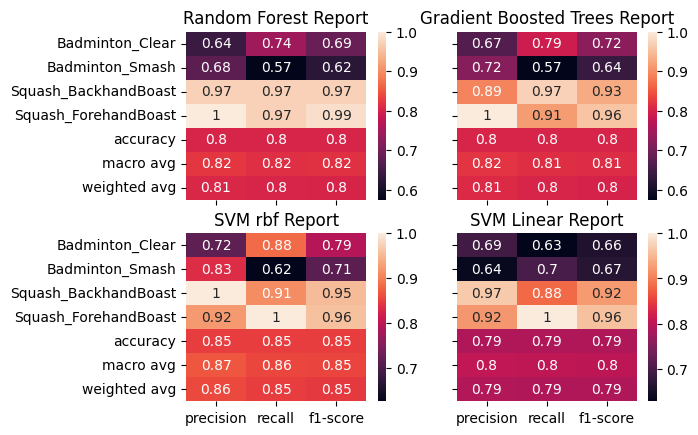

In [ ]:
# Create a figure and four subplots arranged in a 2x2 grid with shared x and y axes
figure, axes = plt.subplots(2, 2, sharex = True, sharey = True)

sns.heatmap(pd.DataFrame(random_forest_report).iloc[:-1, :].T, annot=True, ax = axes[0][0])
axes[0][0].set_title('Random Forest Report')

sns.heatmap(pd.DataFrame(gradient_boosted_trees_report).iloc[:-1, :].T, annot=True, ax = axes[0][1])
axes[0][1].set_title('Gradient Boosted Trees Report')

sns.heatmap(pd.DataFrame(svm_rbf_report).iloc[:-1, :].T, annot=True, ax = axes[1][0])
axes[1][0].set_title('SVM rbf Report')

sns.heatmap(pd.DataFrame(smv_linear_report).iloc[:-1, :].T, annot=True, ax = axes[1][1])
axes[1][1].set_title('SVM Linear Report')
plt.show()

### Try new models

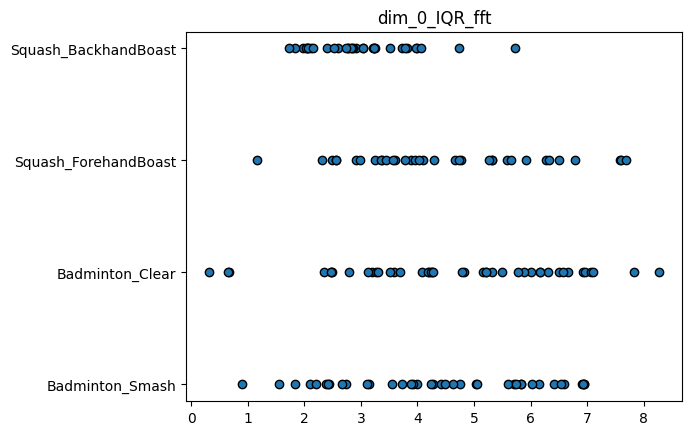

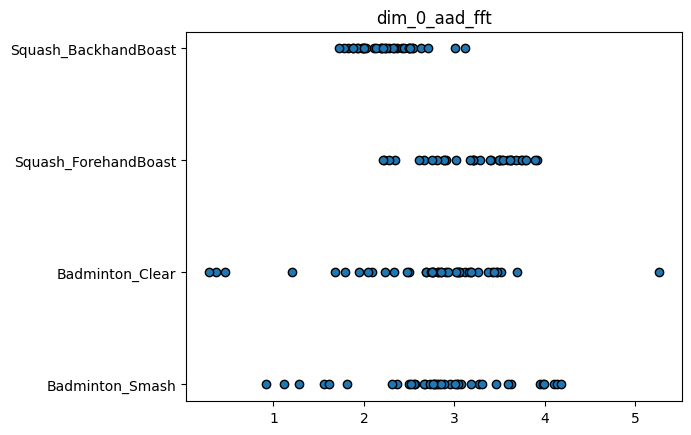

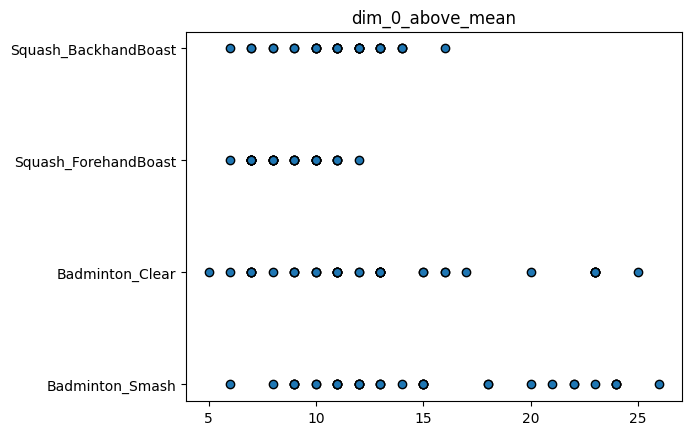

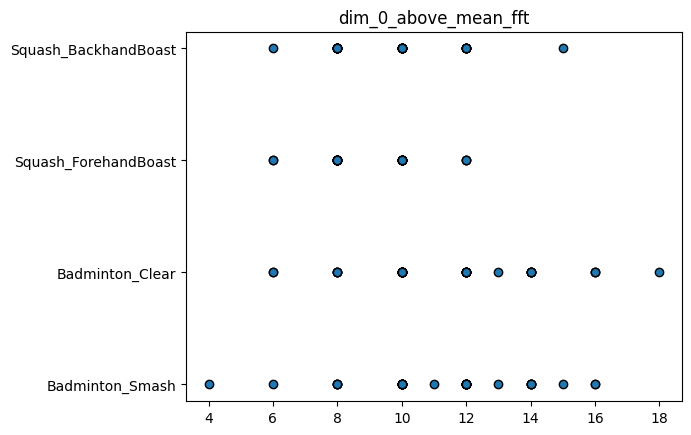

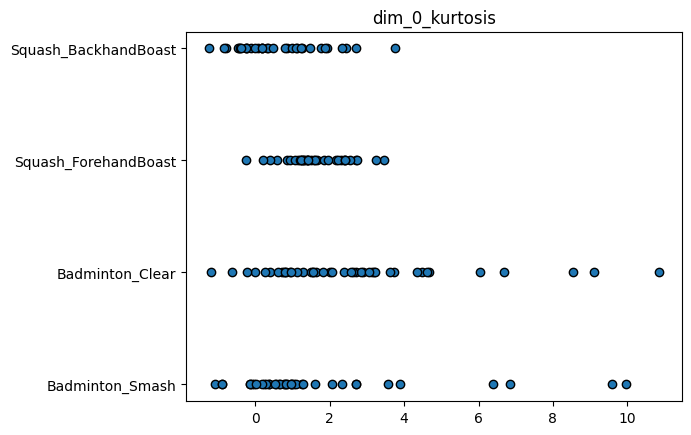

...

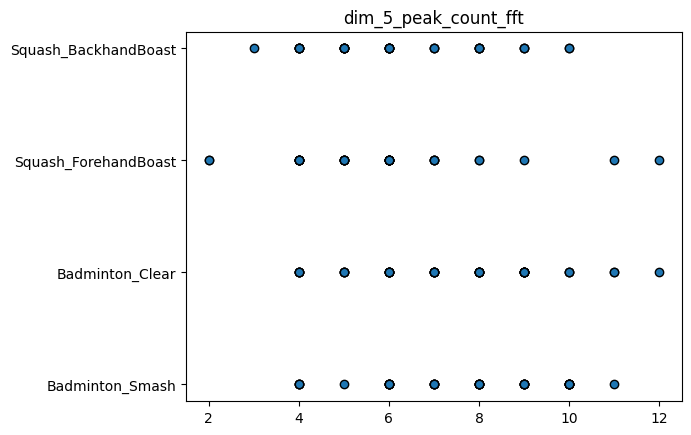

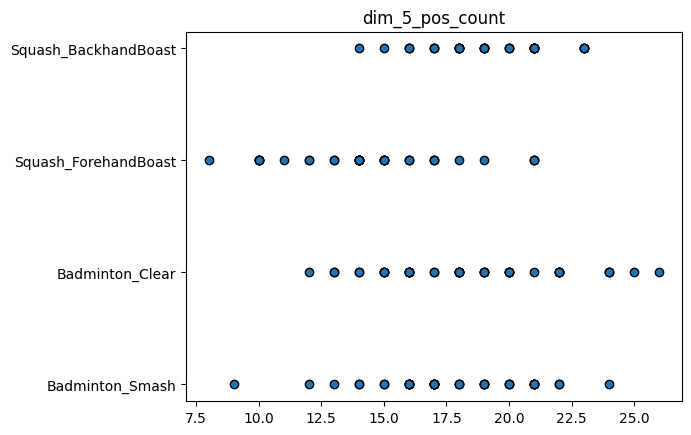

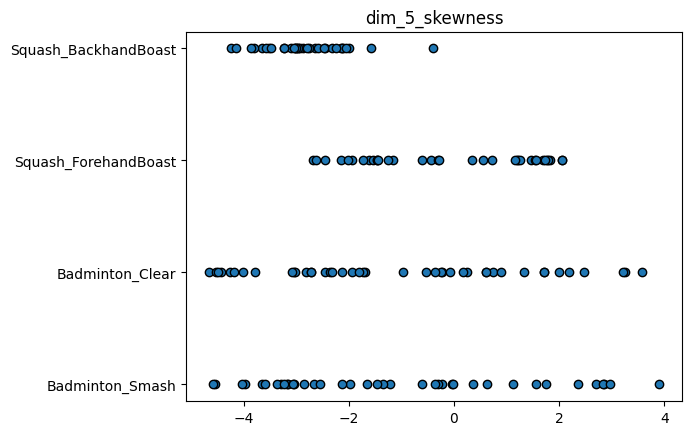

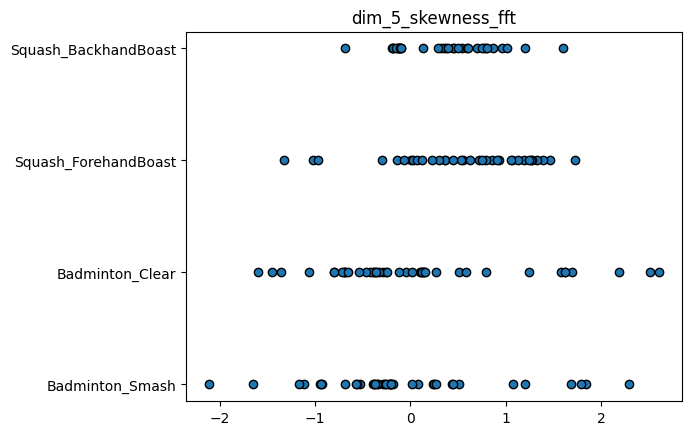

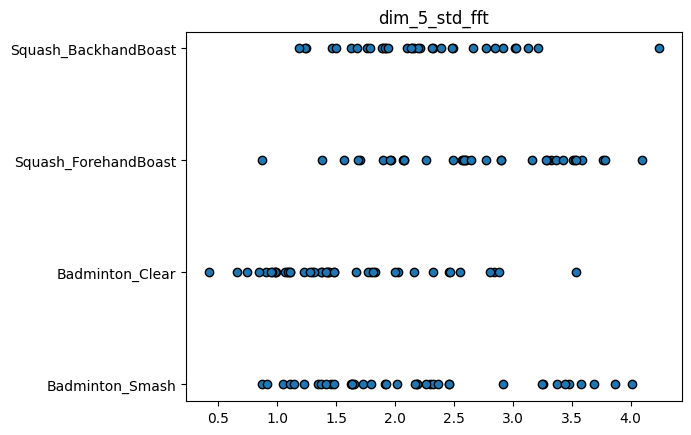

In [ ]:
# Plot a scatter plot with column as x axis, le.inverse_transform(y_train) as y axis,
# o marker and black edge color for each feature extracted

for column in X_train.columns:
  plt.scatter(X_train[column], le.inverse_transform(y_train), marker='o', edgecolor='k')
  plt.title(column)
  plt.show()

#### Random Forest Models

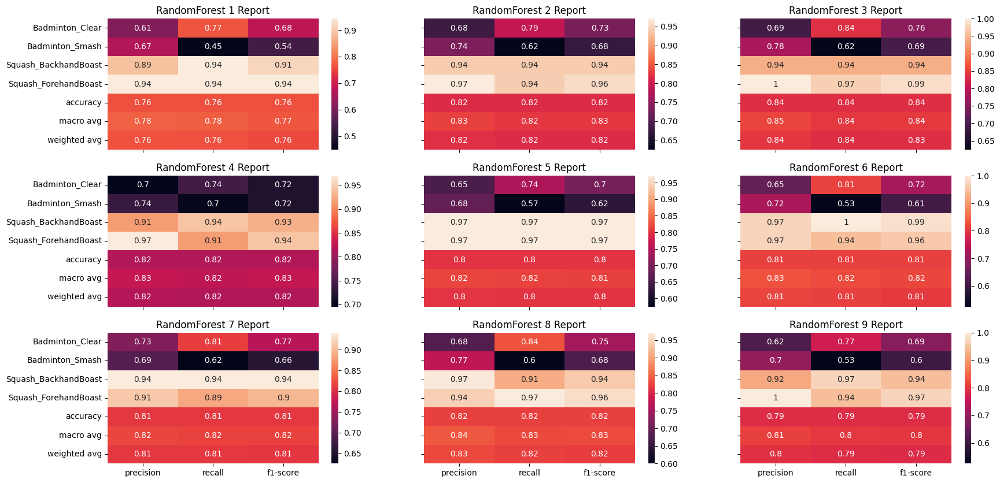

In [ ]:
# Define several instances of Random Forest classifier with different hyperparameters

random_forest_1 = RandomForestClassifier(n_estimators = 60, max_depth = 5, max_samples = 0.3)
random_forest_2 = RandomForestClassifier(n_estimators = 60, max_depth = 5, max_samples = 0.6)
random_forest_3 = RandomForestClassifier(n_estimators = 60, max_depth = 5, max_samples = 0.9)

random_forest_4 = RandomForestClassifier(n_estimators = 120, max_depth = 10, max_samples = 0.3)
random_forest_5 = RandomForestClassifier(n_estimators = 120, max_depth = 10, max_samples = 0.6)
random_forest_6 = RandomForestClassifier(n_estimators = 120, max_depth = 10, max_samples = 0.9)

random_forest_7 = RandomForestClassifier(n_estimators = 80, max_depth = 15, max_samples = 0.3)
random_forest_8 = RandomForestClassifier(n_estimators = 80, max_depth = 15, max_samples = 0.6)
random_forest_9 = RandomForestClassifier(n_estimators = 80, max_depth = 15, max_samples = 0.9)

# Train each instance on the training data

random_forest_1.fit(X_train, y_train)
random_forest_2.fit(X_train, y_train)
random_forest_3.fit(X_train, y_train)
random_forest_4.fit(X_train, y_train)
random_forest_5.fit(X_train, y_train)
random_forest_6.fit(X_train, y_train)
random_forest_7.fit(X_train, y_train)
random_forest_8.fit(X_train, y_train)
random_forest_9.fit(X_train, y_train)

# Evaluate the performance of each instance on the test data using classification_report

random_forest_1_report = classification_report(y_test, le.inverse_transform(random_forest_1.predict(X_test)), output_dict=True)
random_forest_2_report = classification_report(y_test, le.inverse_transform(random_forest_2.predict(X_test)), output_dict=True)
random_forest_3_report = classification_report(y_test, le.inverse_transform(random_forest_3.predict(X_test)), output_dict=True)
random_forest_4_report = classification_report(y_test, le.inverse_transform(random_forest_4.predict(X_test)), output_dict=True)
random_forest_5_report = classification_report(y_test, le.inverse_transform(random_forest_5.predict(X_test)), output_dict=True)
random_forest_6_report = classification_report(y_test, le.inverse_transform(random_forest_6.predict(X_test)), output_dict=True)
random_forest_7_report = classification_report(y_test, le.inverse_transform(random_forest_7.predict(X_test)), output_dict=True)
random_forest_8_report = classification_report(y_test, le.inverse_transform(random_forest_8.predict(X_test)), output_dict=True)
random_forest_9_report = classification_report(y_test, le.inverse_transform(random_forest_9.predict(X_test)), output_dict=True)

# Create a 3x3 grid of subplots and plot the classification reports of the instances

figure, axes = plt.subplots(3, 3, sharex = True, sharey = True)
figure.set_figwidth(20)
figure.set_figheight(10)

report = random_forest_1_report;

# For each subplot, set the report variable to the corresponding instance's report and plot it using a heatmap
for i in range(0, 3):
  for j in range(0, 3):
    if (i) * 3 + (j + 1) == 1:
        report = random_forest_1_report
    elif (i) * 3 + (j + 1) == 2:
        report = random_forest_2_report
    elif (i) * 3 + (j + 1) == 3:
        report = random_forest_3_report
    elif (i) * 3 + (j + 1) == 4:
        report = random_forest_4_report
    elif (i) * 3 + (j + 1) == 5:
        report = random_forest_5_report    
    elif (i) * 3 + (j + 1) == 6:
        report = random_forest_6_report  
    elif (i) * 3 + (j + 1) == 7:
        report = random_forest_7_report  
    elif (i) * 3 + (j + 1) == 8:
        report = random_forest_8_report  
    elif (i) * 3 + (j + 1) == 9:
        report = random_forest_9_report  

    sns.heatmap(pd.DataFrame(report).iloc[:-1, :].T, annot=True, ax = axes[i][j])
    axes[i][j].set_title('RandomForest ' + str((i) * 3 + (j + 1)) + ' Report')
plt.show()

#### Gradient Boosted Trees Models

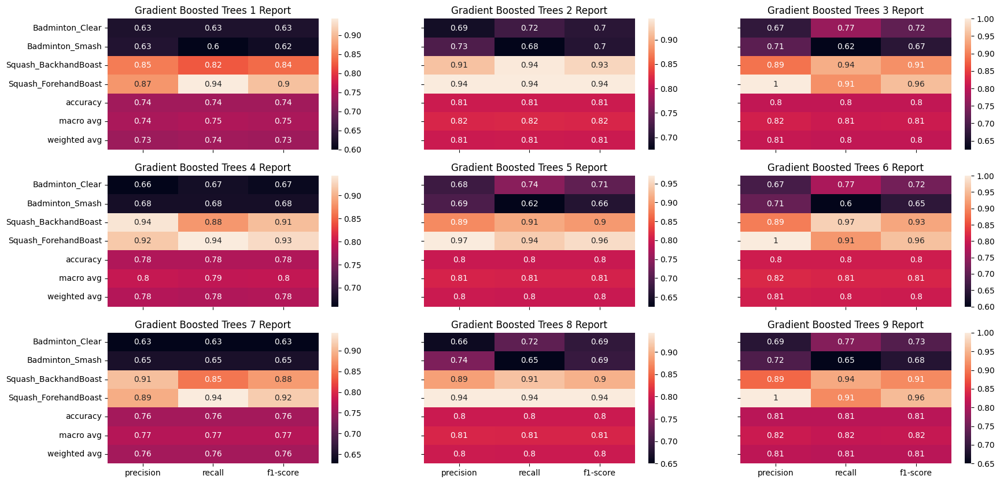

In [ ]:
# Define XGBClassifiers with different hyperparameters

gb_trees_1 = XGBClassifier(n_estimators = 60, max_depth = 5, learning_rate = 0.01)
gb_trees_2 = XGBClassifier(n_estimators = 60, max_depth = 5, learning_rate = 0.1)
gb_trees_3 = XGBClassifier(n_estimators = 60, max_depth = 5, learning_rate = 0.2)

gb_trees_4 = XGBClassifier(n_estimators = 120, max_depth = 10, learning_rate = 0.01)
gb_trees_5 = XGBClassifier(n_estimators = 120, max_depth = 10, learning_rate = 0.1)
gb_trees_6 = XGBClassifier(n_estimators = 120, max_depth = 10, learning_rate = 0.2)

gb_trees_7 = XGBClassifier(n_estimators = 80, max_depth = 15, learning_rate = 0.01)
gb_trees_8 = XGBClassifier(n_estimators = 80, max_depth = 15, learning_rate = 0.1)
gb_trees_9 = XGBClassifier(n_estimators = 80, max_depth = 15, learning_rate = 0.2)

# Fit the XGBClassifiers on the training data

gb_trees_1.fit(X_train, y_train)
gb_trees_2.fit(X_train, y_train)
gb_trees_3.fit(X_train, y_train)
gb_trees_4.fit(X_train, y_train)
gb_trees_5.fit(X_train, y_train)
gb_trees_6.fit(X_train, y_train)
gb_trees_7.fit(X_train, y_train)
gb_trees_8.fit(X_train, y_train)
gb_trees_9.fit(X_train, y_train)

# Generate classification reports for each XGBClassifier using the test data

gb_trees_1_report = classification_report(y_test, le.inverse_transform(gb_trees_1.predict(X_test)), output_dict=True)
gb_trees_2_report = classification_report(y_test, le.inverse_transform(gb_trees_2.predict(X_test)), output_dict=True)
gb_trees_3_report = classification_report(y_test, le.inverse_transform(gb_trees_3.predict(X_test)), output_dict=True)
gb_trees_4_report = classification_report(y_test, le.inverse_transform(gb_trees_4.predict(X_test)), output_dict=True)
gb_trees_5_report = classification_report(y_test, le.inverse_transform(gb_trees_5.predict(X_test)), output_dict=True)
gb_trees_6_report = classification_report(y_test, le.inverse_transform(gb_trees_6.predict(X_test)), output_dict=True)
gb_trees_7_report = classification_report(y_test, le.inverse_transform(gb_trees_7.predict(X_test)), output_dict=True)
gb_trees_8_report = classification_report(y_test, le.inverse_transform(gb_trees_8.predict(X_test)), output_dict=True)
gb_trees_9_report = classification_report(y_test, le.inverse_transform(gb_trees_9.predict(X_test)), output_dict=True)

# Create a 3x3 grid of subplots for displaying the classification reports

figure, axes = plt.subplots(3, 3, sharex = True, sharey = True)
figure.set_figwidth(20)
figure.set_figheight(10)

report = random_forest_1_report;

# For each subplot, set the report variable to the corresponding instance's report and plot it using a heatmap

for i in range(0, 3):
  for j in range(0, 3):
    if (i) * 3 + (j + 1) == 1:
        report = gb_trees_1_report
    elif (i) * 3 + (j + 1) == 2:
        report = gb_trees_2_report
    elif (i) * 3 + (j + 1) == 3:
        report = gb_trees_3_report
    elif (i) * 3 + (j + 1) == 4:
        report = gb_trees_4_report
    elif (i) * 3 + (j + 1) == 5:
        report = gb_trees_5_report    
    elif (i) * 3 + (j + 1) == 6:
        report = gb_trees_6_report  
    elif (i) * 3 + (j + 1) == 7:
        report = gb_trees_7_report  
    elif (i) * 3 + (j + 1) == 8:
        report = gb_trees_8_report  
    elif (i) * 3 + (j + 1) == 9:
        report = gb_trees_9_report  

    sns.heatmap(pd.DataFrame(report).iloc[:-1, :].T, annot=True, ax = axes[i][j])
    axes[i][j].set_title('Gradient Boosted Trees ' + str((i) * 3 + (j + 1)) + ' Report')
plt.show()

#### SVM Models

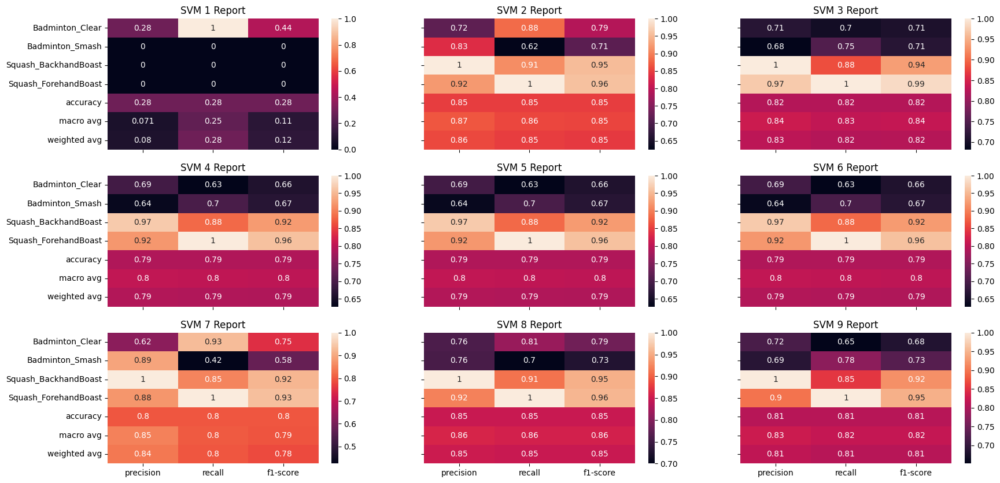

In [ ]:
# Define SVM Classifiers with different hyperparameters

svm_1 = SVC(kernel = 'rbf', C = 0.1)
svm_2 = SVC(kernel = 'rbf', C = 1)
svm_3 = SVC(kernel = 'rbf', C = 10)

svm_4 = SVC(kernel = 'linear', C = 0.1)
svm_5 = SVC(kernel = 'linear', C = 1)
svm_6 = SVC(kernel = 'linear', C = 10)

svm_7 = SVC(kernel = 'poly', C = 0.1)
svm_8 = SVC(kernel = 'poly', C = 1)
svm_9 = SVC(kernel = 'poly', C = 10)

# Fit the SVM on the training data

svm_1.fit(X_train, y_train)
svm_2.fit(X_train, y_train)
svm_3.fit(X_train, y_train)
svm_4.fit(X_train, y_train)
svm_5.fit(X_train, y_train)
svm_6.fit(X_train, y_train)
svm_7.fit(X_train, y_train)
svm_8.fit(X_train, y_train)
svm_9.fit(X_train, y_train)

# Generate classification reports for each SVM using the test data

svm_1_report = classification_report(y_test, le.inverse_transform(svm_1.predict(X_test)), output_dict=True)
svm_2_report = classification_report(y_test, le.inverse_transform(svm_2.predict(X_test)), output_dict=True)
svm_3_report = classification_report(y_test, le.inverse_transform(svm_3.predict(X_test)), output_dict=True)
svm_4_report = classification_report(y_test, le.inverse_transform(svm_4.predict(X_test)), output_dict=True)
svm_5_report = classification_report(y_test, le.inverse_transform(svm_5.predict(X_test)), output_dict=True)
svm_6_report = classification_report(y_test, le.inverse_transform(svm_6.predict(X_test)), output_dict=True)
svm_7_report = classification_report(y_test, le.inverse_transform(svm_7.predict(X_test)), output_dict=True)
svm_8_report = classification_report(y_test, le.inverse_transform(svm_8.predict(X_test)), output_dict=True)
svm_9_report = classification_report(y_test, le.inverse_transform(svm_9.predict(X_test)), output_dict=True)

# Create a 3x3 grid of subplots for displaying the classification reports

figure, axes = plt.subplots(3, 3, sharex = True, sharey = True)
figure.set_figwidth(20)
figure.set_figheight(10)

report = svm_1_report;

# For each subplot, set the report variable to the corresponding instance's report and plot it using a heatmap

for i in range(0, 3):
  for j in range(0, 3):
    if (i) * 3 + (j + 1) == 1:
        report = svm_1_report
    elif (i) * 3 + (j + 1) == 2:
        report = svm_2_report
    elif (i) * 3 + (j + 1) == 3:
        report = svm_3_report
    elif (i) * 3 + (j + 1) == 4:
        report = svm_4_report
    elif (i) * 3 + (j + 1) == 5:
        report = svm_5_report    
    elif (i) * 3 + (j + 1) == 6:
        report = svm_6_report  
    elif (i) * 3 + (j + 1) == 7:
        report = svm_7_report  
    elif (i) * 3 + (j + 1) == 8:
        report = svm_8_report  
    elif (i) * 3 + (j + 1) == 9:
        report = svm_9_report  

    sns.heatmap(pd.DataFrame(report).iloc[:-1, :].T, annot=True, ax = axes[i][j])
    axes[i][j].set_title('SVM ' + str((i) * 3 + (j + 1)) + ' Report')
plt.show()

### Use GridSearch CV

#### Random Forest Search Model

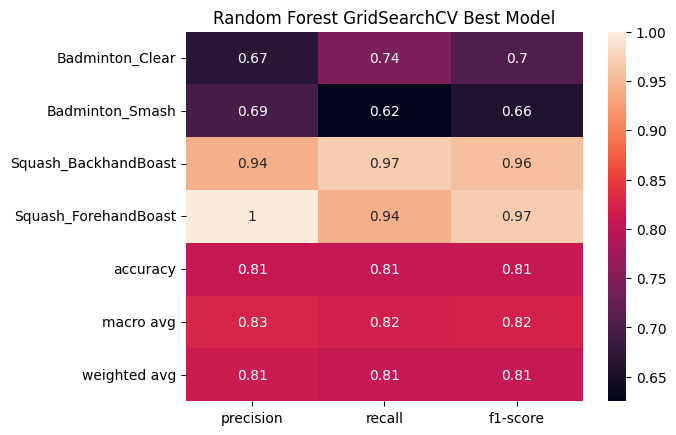

{'max_depth': 4, 'max_samples': 0.4, 'n_estimators': 250}
RandomForestClassifier(max_depth=4, max_samples=0.4, n_estimators=250)


In [ ]:
# Define a dictionary of hyperparameters for the Random Forest Classifier model
parameters = {
    'max_depth': [2, 4, 6, 5, 7, 8, 9, 10, 11, 12, 15, 17, 20, 25],
    'n_estimators': [50, 70, 100, 125, 150, 200, 250, 300],
    'max_samples': [0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9]
}

# Initialize the GridSearchCV object with the Random Forest Classifier model, the hyperparameter dictionary, and other necessary parameters
random_forest_gridSearchCV = GridSearchCV(RandomForestClassifier(), parameters, refit = True, cv = 5)

# Train the GridSearchCV object on the training data
random_forest_gridSearchCV.fit(X_train, y_train)

# Generate a classification report for the best model identified by the GridSearchCV
random_forest_gridSearchCV_report = classification_report(y_test, le.inverse_transform(random_forest_gridSearchCV.predict(X_test)), output_dict=True)

# Create a heatmap of the classification report for better visualization
ax = plt.axes()
sns.heatmap(pd.DataFrame(random_forest_gridSearchCV_report).iloc[:-1, :].T, annot=True, ax = ax)

ax.set_title('Random Forest GridSearchCV Best Model')
plt.show()

# Print the best hyperparameters identified by the GridSearchCV
print(random_forest_gridSearchCV.best_params_)
print(random_forest_gridSearchCV.best_estimator_)

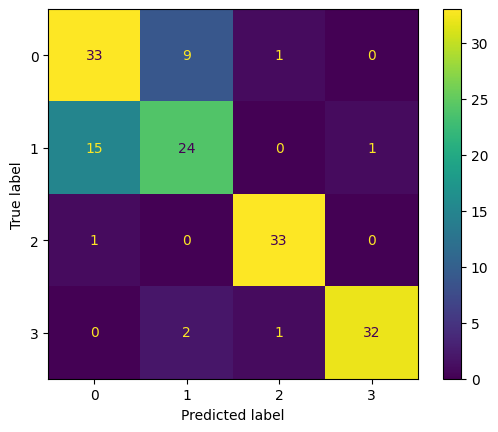

In [ ]:
# Confusion Matrix

random_forest_best = RandomForestClassifier(n_estimators = 150, max_depth = 20, max_samples = 0.5)
random_forest_best.fit(X_train, y_train)

random_forest_cm = confusion_matrix(y_test, le.inverse_transform(random_forest_best.predict(X_test)))

cm_display = metrics.ConfusionMatrixDisplay(confusion_matrix = random_forest_cm)
cm_display.plot()
plt.show()

#### Gradient Boosted Trees Search Model

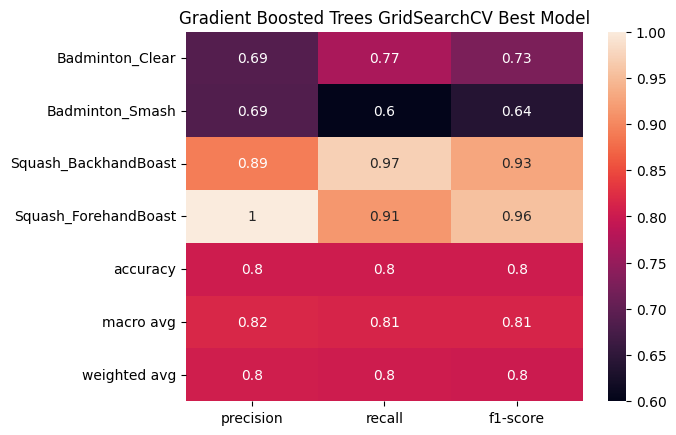

{'learning_rate': 0.2, 'max_depth': 6, 'n_estimators': 100}
XGBClassifier(base_score=None, booster=None, callbacks=None,
              colsample_bylevel=None, colsample_bynode=None,
              colsample_bytree=None, early_stopping_rounds=None,
              enable_categorical=False, eval_metric=None, feature_types=None,
              gamma=None, gpu_id=None, grow_policy=None, importance_type=None,
              interaction_constraints=None, learning_rate=0.2, max_bin=None,
              max_cat_threshold=None, max_cat_to_onehot=None,
              max_delta_step=None, max_depth=6, max_leaves=None,
              min_child_weight=None, missing=nan, monotone_constraints=None,
              n_estimators=100, n_jobs=None, nthread=4, num_parallel_tree=None,
              objective='multi:softmax', ...)


In [ ]:
# XGBoost Classifier Initialization
estimator = XGBClassifier(objective= 'multi:softmax', nthread=4, seed=42)

# Parameter grid for Grid Search Cross Validation
parameters = {
    'max_depth': [2, 4, 6, 8, 10, 12, 15, 17, 20, 25],
    'n_estimators': [50, 70, 100, 125, 150, 200, 250, 300],
    'learning_rate': [0.05, 0.1, 0.15, 0.2, 0.25]
}

# Grid Search Cross Validation Initialization
gb_trees_gridSearchCV = GridSearchCV(estimator=estimator, param_grid=parameters, n_jobs = 4, cv = 5, refit = True)

# Fitting the Grid Search Cross Validation with training data
gb_trees_gridSearchCV.fit(X_train, y_train)

# Generating classification report for the test data
gb_trees_gridSearchCV_report = classification_report(y_test, le.inverse_transform(gb_trees_gridSearchCV.predict(X_test)), output_dict=True)

# Plotting Heatmap for Classification Report
ax = plt.axes()
sns.heatmap(pd.DataFrame(gb_trees_gridSearchCV_report).iloc[:-1, :].T, annot=True, ax = ax)

ax.set_title('Gradient Boosted Trees GridSearchCV Best Model')
plt.show()

# Printing the best parameters and estimator from the Grid Search Cross Validation
print(gb_trees_gridSearchCV.best_params_)
print(gb_trees_gridSearchCV.best_estimator_)

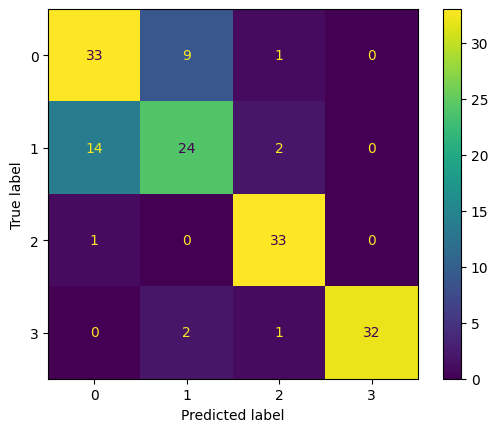

In [ ]:
# Confusion Matrix

gb_trees_best = XGBClassifier(n_estimators = 100, max_depth = 6, learning_rate = 0.2)
gb_trees_best.fit(X_train, y_train)

gb_trees_cm = confusion_matrix(y_test, le.inverse_transform(gb_trees_best.predict(X_test)))

cm_display = metrics.ConfusionMatrixDisplay(confusion_matrix = gb_trees_cm)
cm_display.plot()
plt.show()

#### SVM Search Model

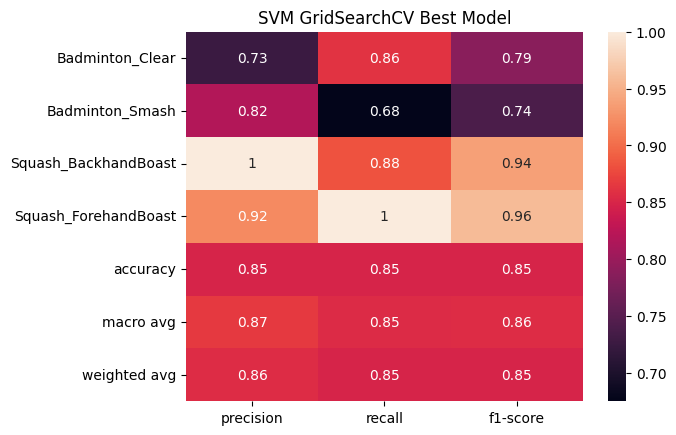

{'C': 0.6, 'kernel': 'poly'}
SVC(C=0.6, kernel='poly')


In [ ]:
# Define a dictionary of parameter ranges to search over
parameters = {'kernel':['poly', 'linear', 'rbf'], 'C':[0.08, 0.09, 0.1, 0.2, 0.3, 0.4, 0.55, 0.75, 0.8, 0.6, 0.7, 1, 2]}

# Create a GridSearchCV object with the SVM classifier and the parameter ranges to search over
svm_gridSearchCV = GridSearchCV(SVC(), parameters, refit = True, cv = 5)

# Train the GridSearchCV object on the training data
svm_gridSearchCV.fit(X_train, y_train)

# Generate a classification report on the test data for the best model found by GridSearchCV
svm_gridSearchCV_report = classification_report(y_test, le.inverse_transform(svm_gridSearchCV.predict(X_test)), output_dict=True)

# Create a heatmap of the classification report using Seaborn
ax = plt.axes()
sns.heatmap(pd.DataFrame(svm_gridSearchCV_report).iloc[:-1, :].T, annot=True, ax = ax)

ax.set_title('SVM GridSearchCV Best Model')
plt.show()

# Print the parameters of the best model found by GridSearchCV
print(svm_gridSearchCV.best_params_)
print(svm_gridSearchCV.best_estimator_)

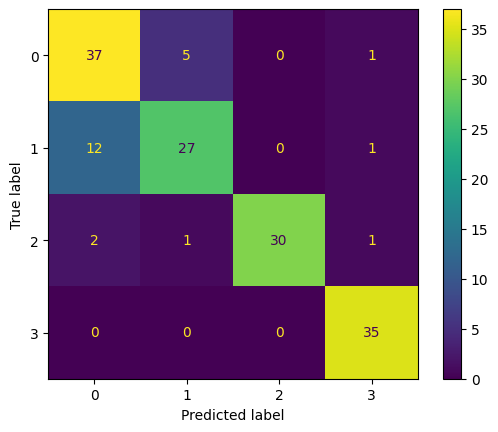

In [ ]:
# Confusion Matrix

svm_best = SVC(kernel = 'poly', C = 0.6)
svm_best.fit(X_train, y_train)

svm_best_cm = confusion_matrix(y_test, le.inverse_transform(svm_best.predict(X_test)))

cm_display = metrics.ConfusionMatrixDisplay(confusion_matrix = svm_best_cm)
cm_display.plot()
plt.show()